# **Waste Material Segregation for Improving Waste Management**

## **Objective**

The objective of this project is to implement an effective waste material segregation system using convolutional neural networks (CNNs) that categorises waste into distinct groups. This process enhances recycling efficiency, minimises environmental pollution, and promotes sustainable waste management practices.

The key goals are:

* Accurately classify waste materials into categories like cardboard, glass, paper, and plastic.
* Improve waste segregation efficiency to support recycling and reduce landfill waste.
* Understand the properties of different waste materials to optimise sorting methods for sustainability.

## **Data Understanding**

The Dataset consists of images of some common waste materials.

1. Food Waste
2. Metal
3. Paper
4. Plastic
5. Other
6. Cardboard
7. Glass


**Data Description**

* The dataset consists of multiple folders, each representing a specific class, such as `Cardboard`, `Food_Waste`, and `Metal`.
* Within each folder, there are images of objects that belong to that category.
* However, these items are not further subcategorised. <br> For instance, the `Food_Waste` folder may contain images of items like coffee grounds, teabags, and fruit peels, without explicitly stating that they are actually coffee grounds or teabags.

## **1. Load the data**

Load and unzip the dataset zip file.

**Import Necessary Libraries**

In [1]:
# Recommended versions:

# numpy version: 1.26.4
# pandas version: 2.2.2
# seaborn version: 0.13.2
# matplotlib version: 3.10.0
# PIL version: 11.1.0
# tensorflow version: 2.18.0
# keras version: 3.8.0
# sklearn version: 1.6.1

In [2]:
# Import essential libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import PIL
import tensorflow as tf
import keras
import sklearn
import os

from keras.src.layers import Dense
from keras.src.utils import to_categorical

# from july7.test import X_train
from sklearn.model_selection import train_test_split

Load the dataset.

In [3]:
# Load and unzip the dataset
path = "./data/data"

## **2. Data Preparation** <font color=red> [25 marks] </font><br>


### **2.1 Load and Preprocess Images** <font color=red> [8 marks] </font><br>

Let us create a function to load the images first. We can then directly use this function while loading images of the different categories to load and crop them in a single step.

#### **2.1.1** <font color=red> [3 marks] </font><br>
Create a function to load the images.

In [4]:
# Create a function to load the raw images
def load_images(path):
    img_data = tf.keras.utils.image_dataset_from_directory(path)
    return img_data

#### **2.1.2** <font color=red> [5 marks] </font><br>
Load images and labels.

Load the images from the dataset directory. Labels of images are present in the subdirectories.

Verify if the images and labels are loaded correctly.

In [5]:
# Get the images and their labels

img_data = load_images(path)
print(img_data.class_names)
print(img_data)

Found 7625 files belonging to 7 classes.
['Cardboard', 'Food_Waste', 'Glass', 'Metal', 'Other', 'Paper', 'Plastic']
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>


Perform any operations, if needed, on the images and labels to get them into the desired format.

### **2.2 Data Visualisation** <font color=red> [9 marks] </font><br>

#### **2.2.1** <font color=red> [3 marks] </font><br>
Create a bar plot to display the class distribution

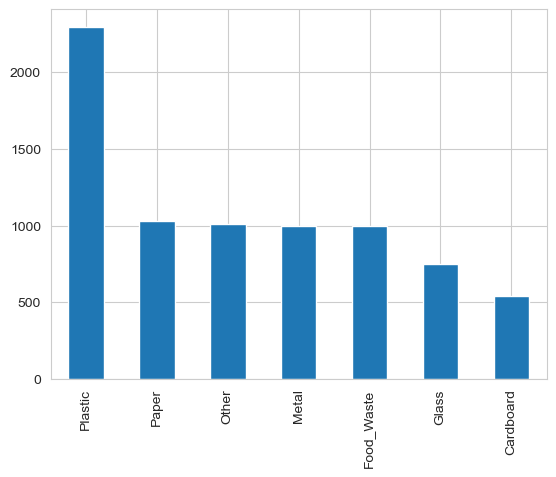

In [6]:
# Visualise Data Distribution
label_list = []
img_list = []
# a = []
b = []


def extract_labels(dataset, class_names):
    for img, labels in dataset:
        # print(labels)

        label_list.extend(labels.numpy())
        img_list.extend(img.numpy())
        # print(img_list)
    # print(label_list)
    a = [class_names[i] for i in label_list]
    # print(a)
    b.extend([class_names[i] for i in label_list])
    a = pd.Series(a)
    a.value_counts().plot.bar()
    plt.show()


extract_labels(img_data, img_data.class_names)

#### **2.2.2** <font color=red> [3 marks] </font><br>
Visualise some sample images

Metal


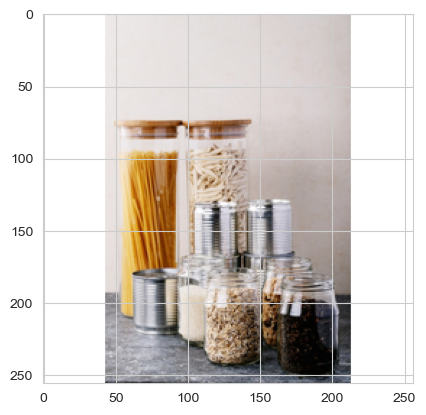

Glass


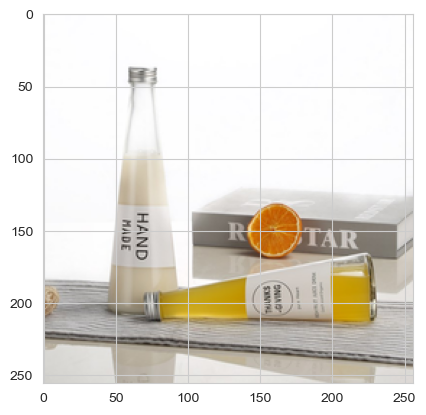

Metal


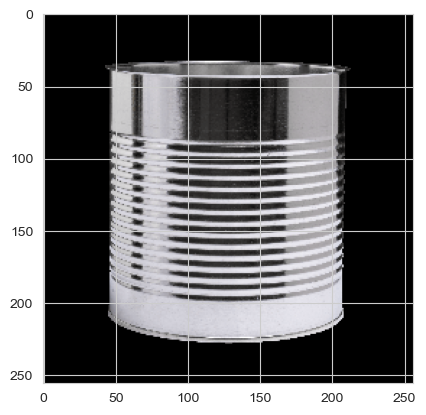

Metal


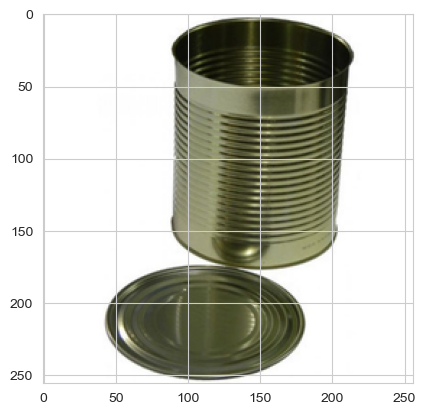

Other


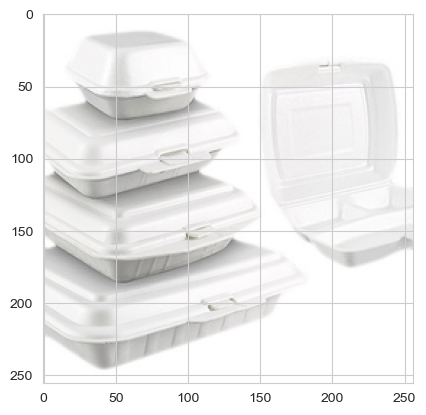

Metal


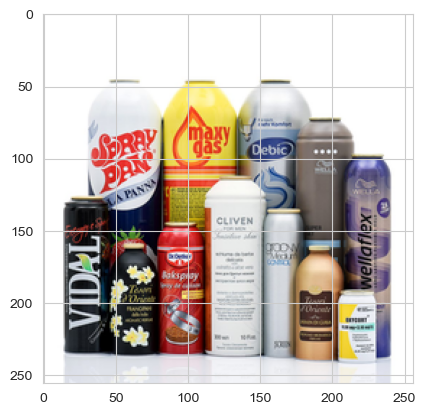

Plastic


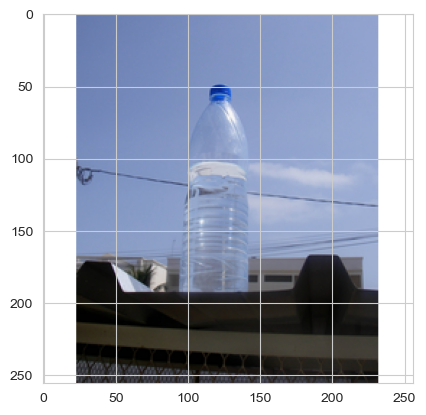

Plastic


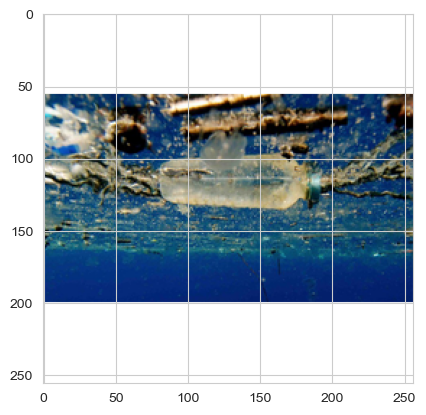

Paper


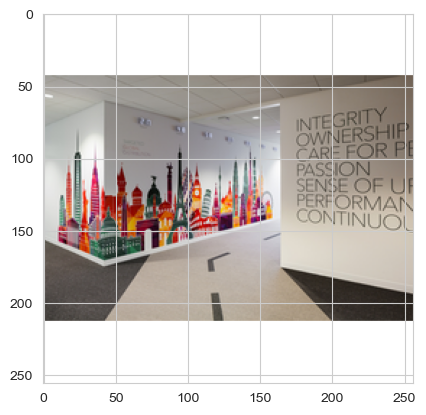

Food_Waste


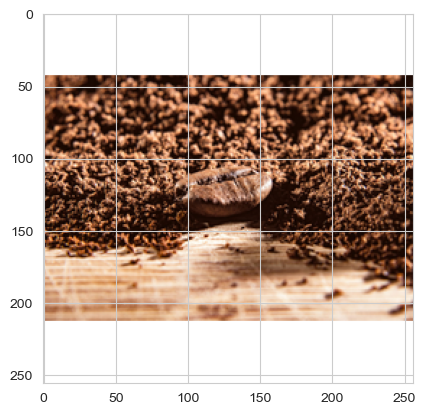

Plastic


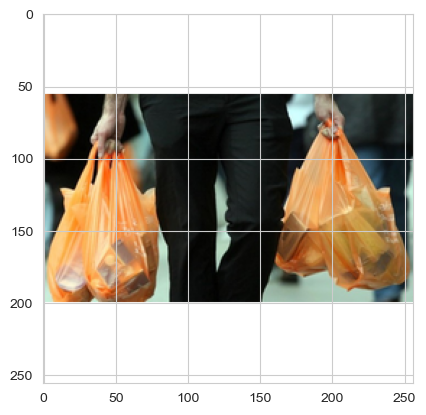

Plastic


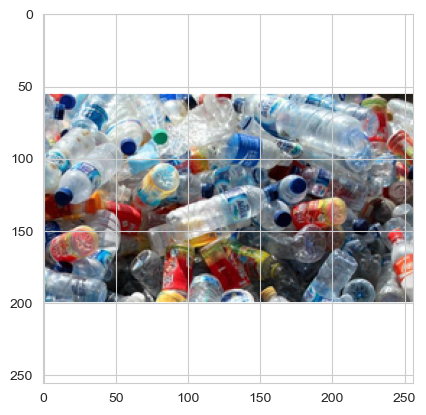

Plastic


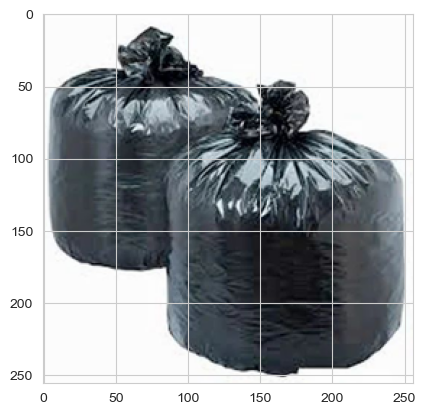

Other


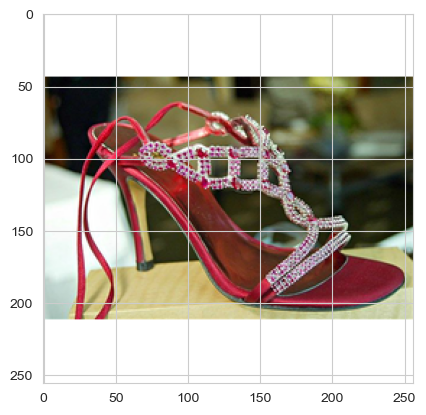

Paper


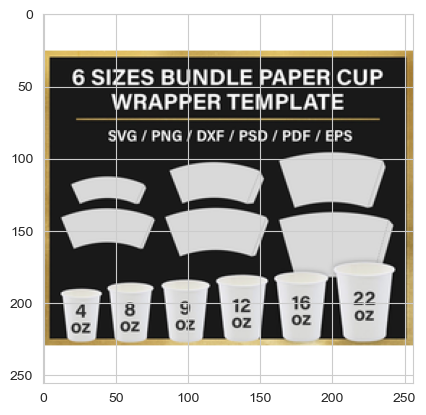

Metal


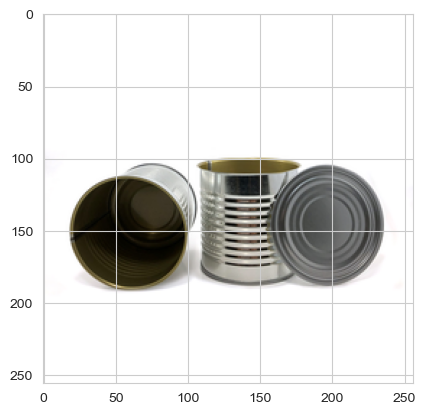

Plastic


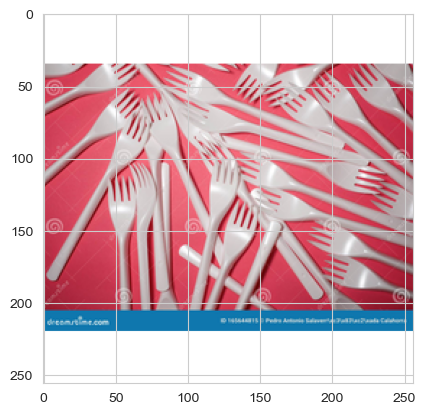

Other


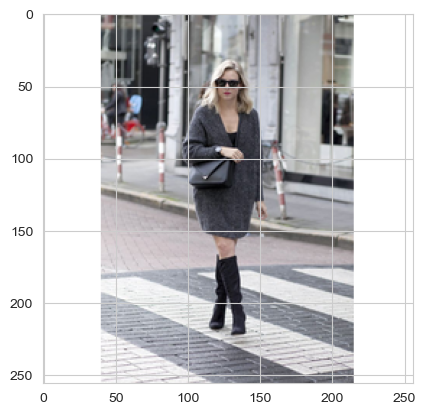

Plastic


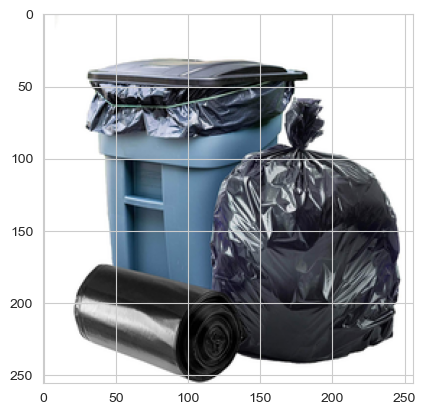

Paper


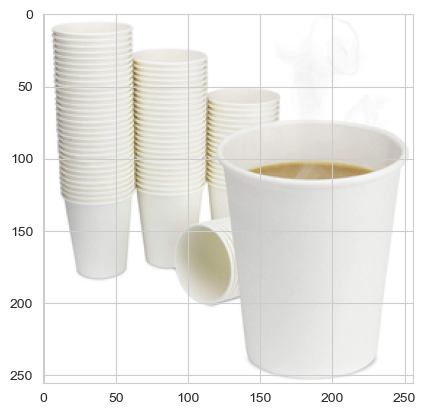

Food_Waste


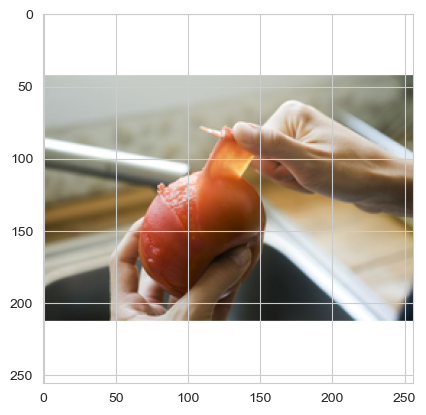

Other


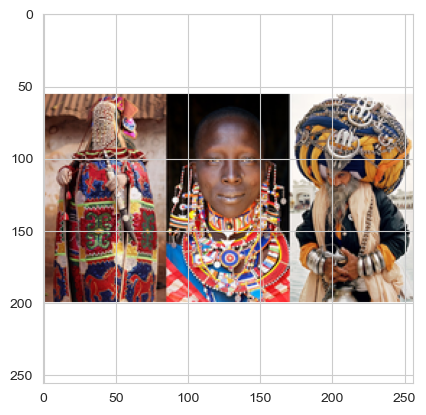

Other


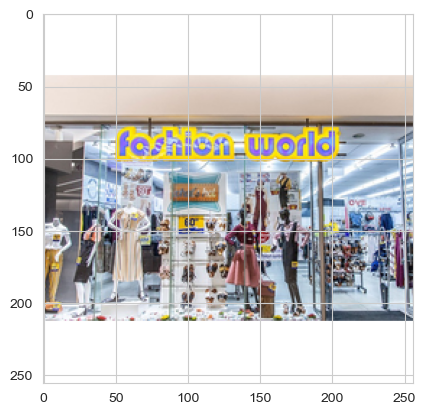

Plastic


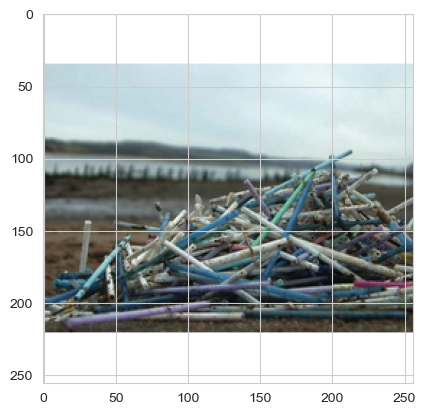

Plastic


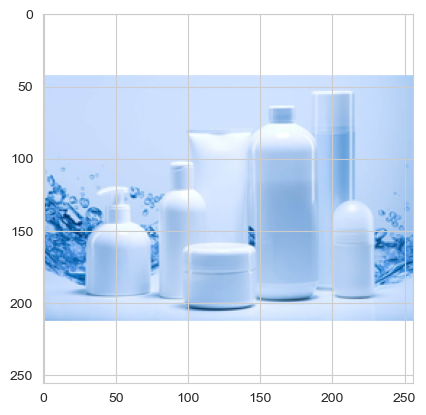

Metal


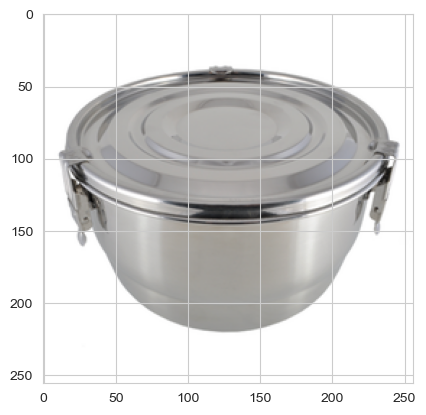

Plastic


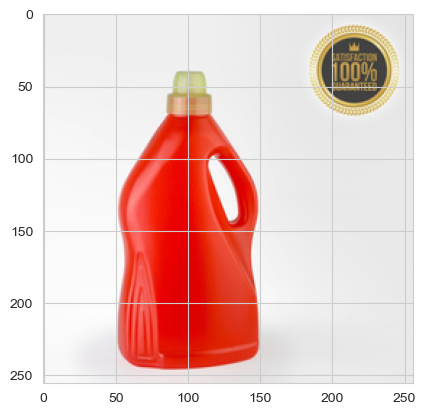

Food_Waste


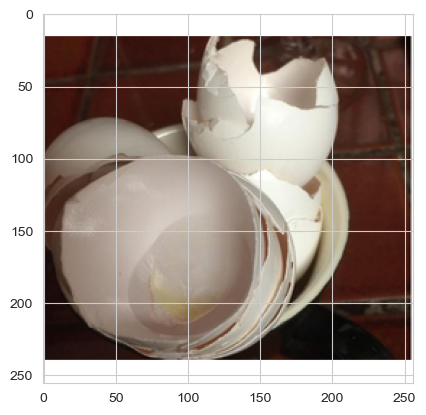

Other


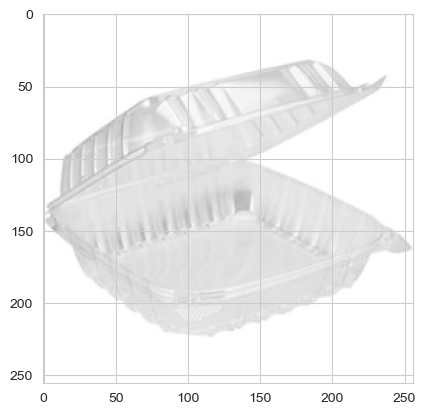

Metal


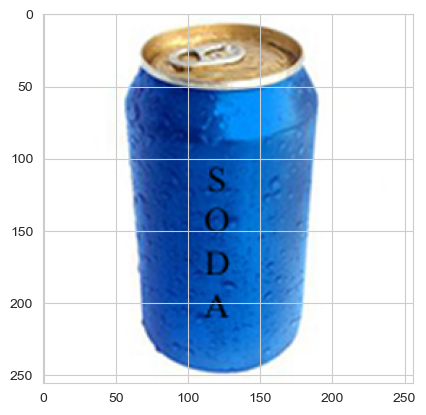

Other


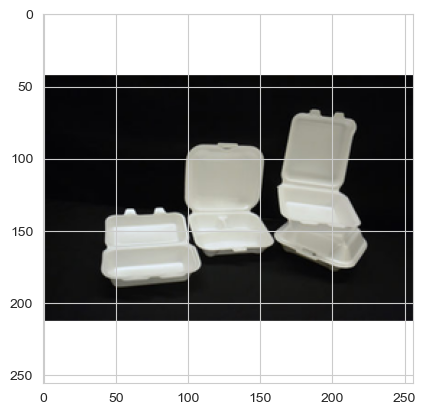

Plastic


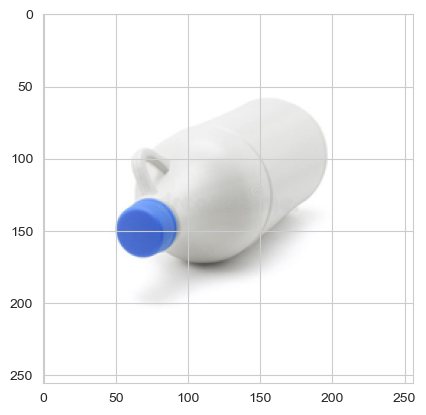

Other


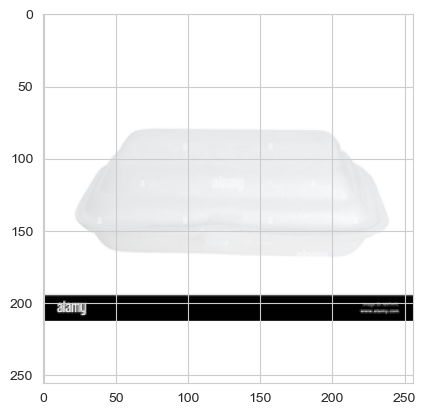

Food_Waste


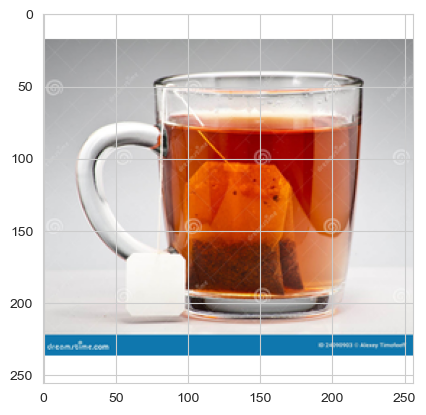

Cardboard


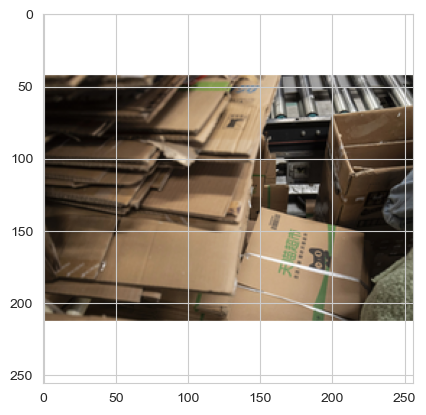

Paper


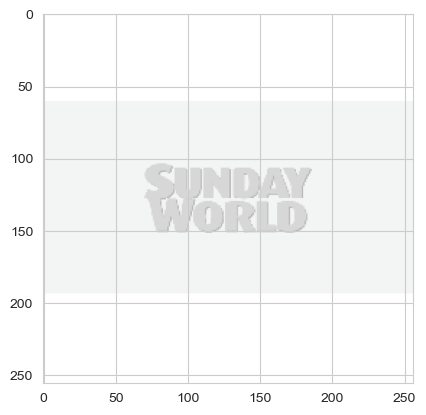

Paper


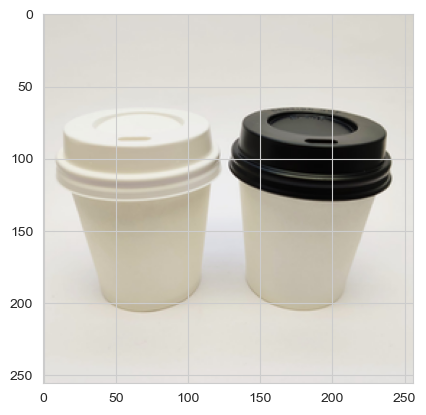

Other


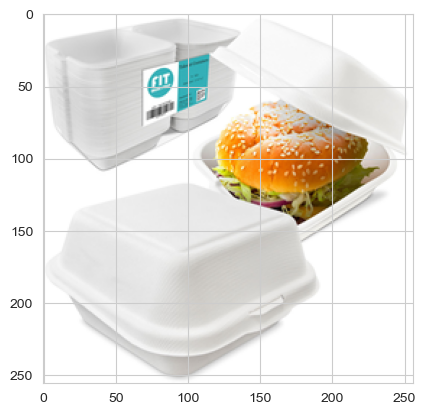

Plastic


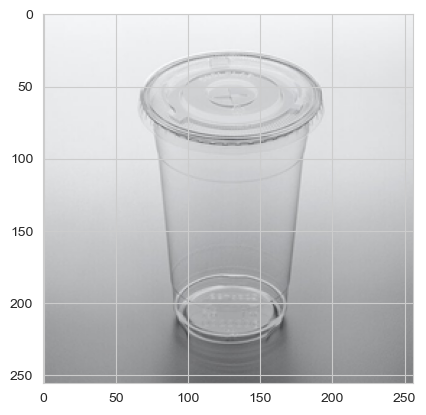

Plastic


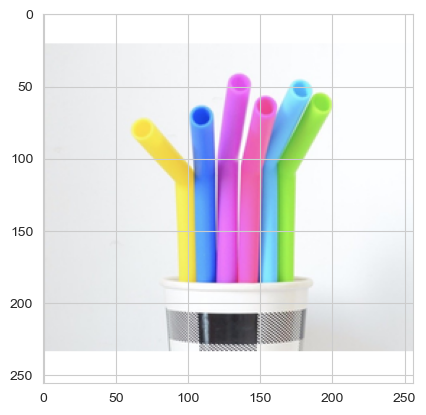

Plastic


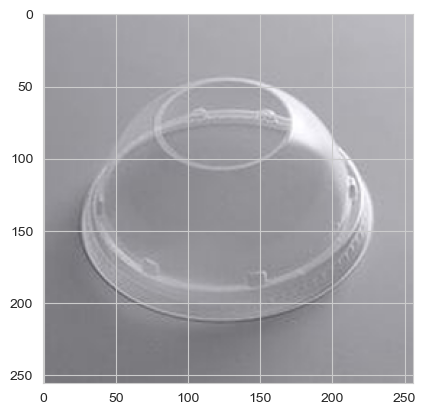

Paper


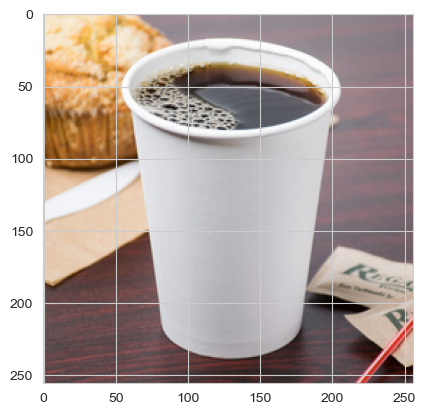

Glass


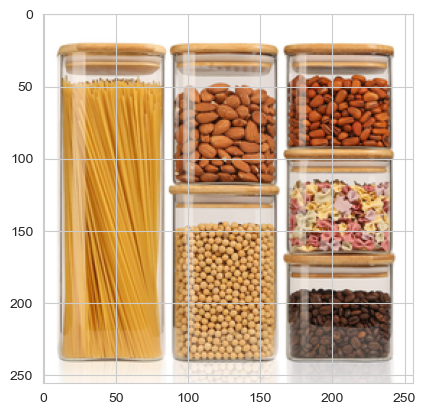

Food_Waste


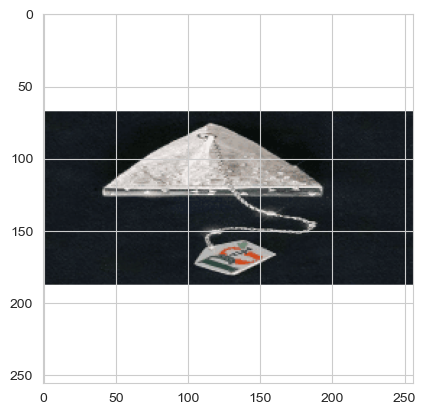

Paper


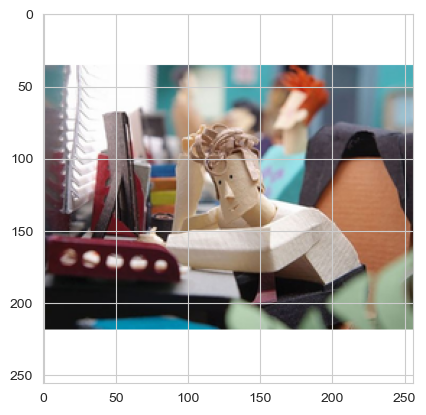

Plastic


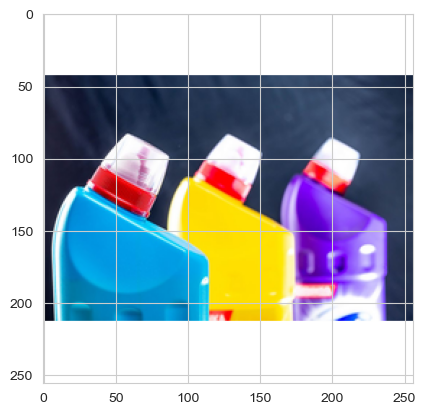

Plastic


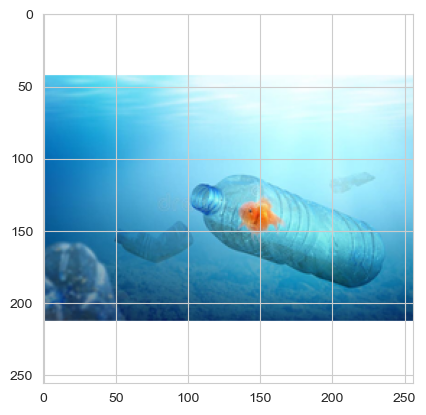

Paper


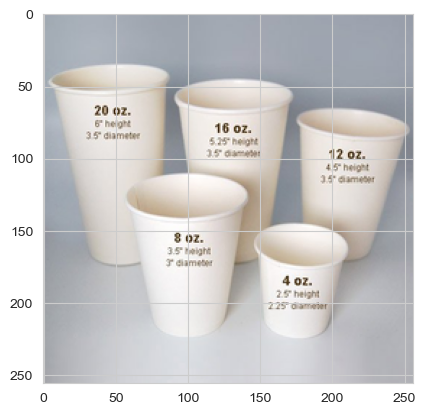

Plastic


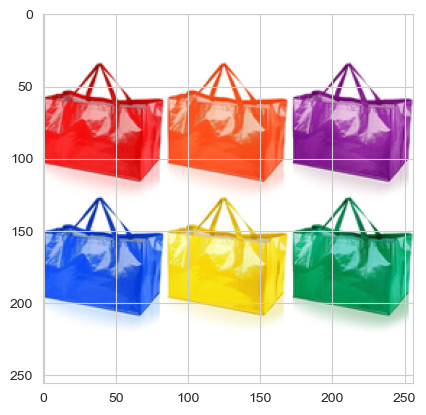

Plastic


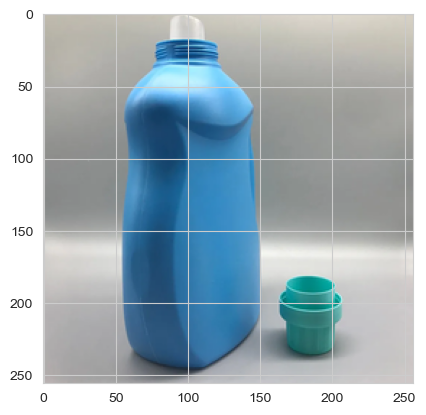

Other


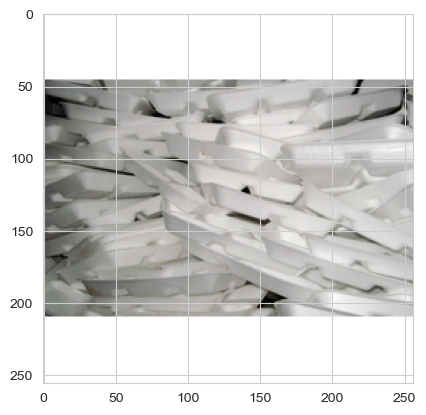

Paper


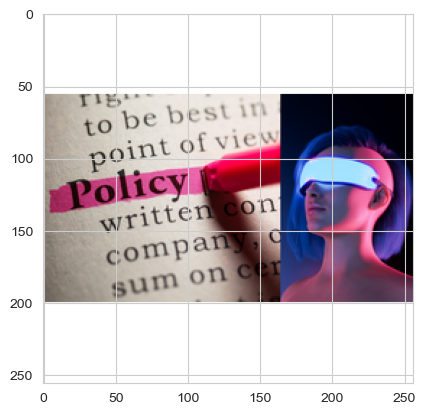

Plastic


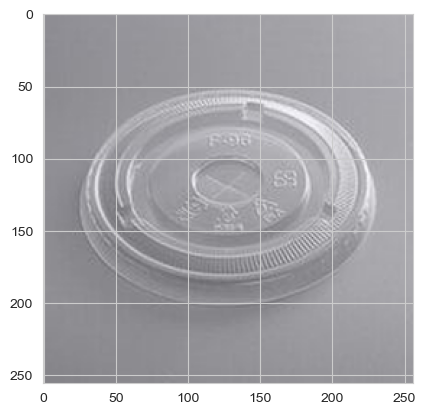

Metal


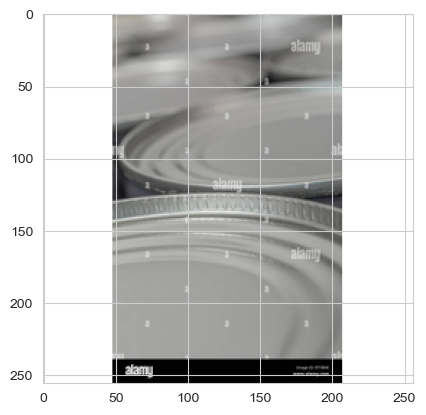

Plastic


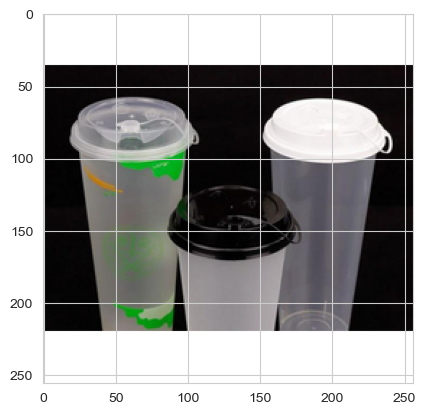

Metal


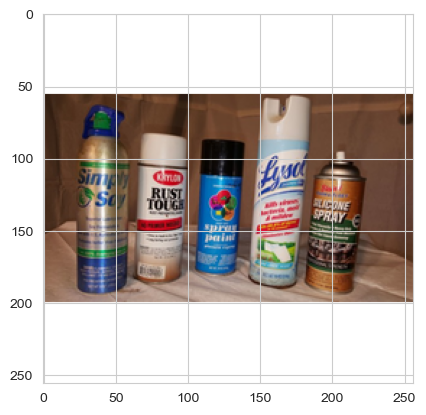

Plastic


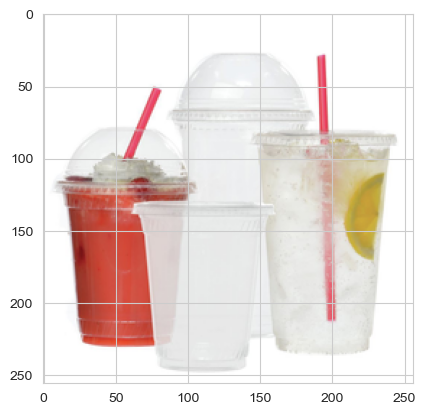

Plastic


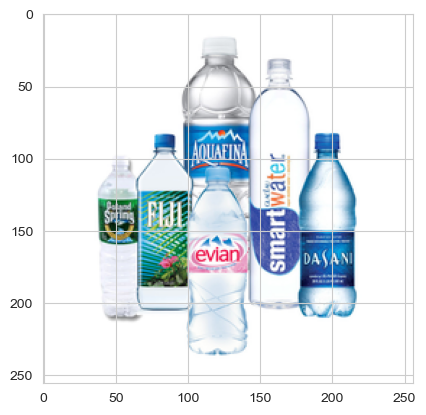

Food_Waste


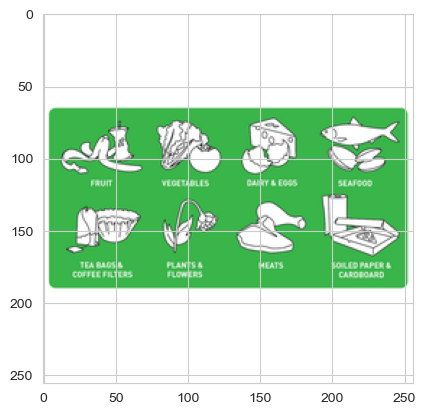

Cardboard


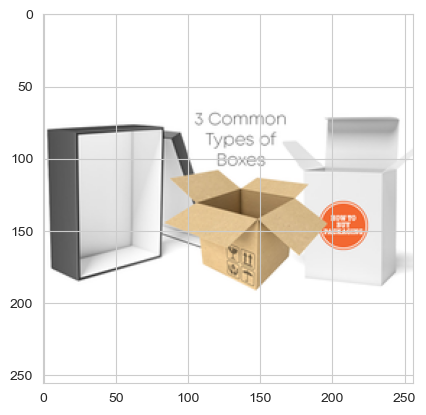

Other


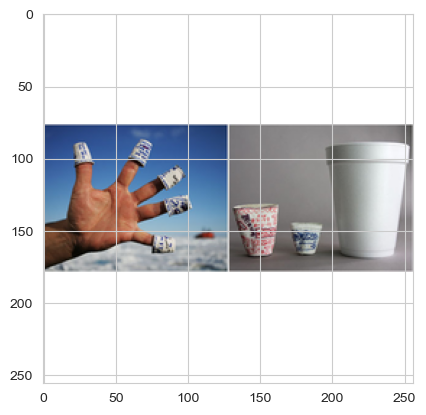

Cardboard


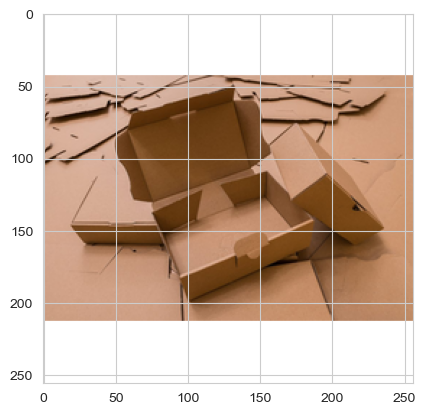

Paper


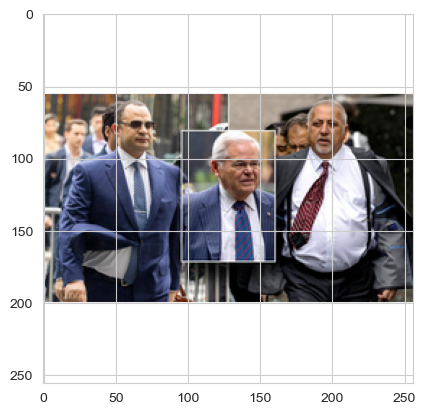

Plastic


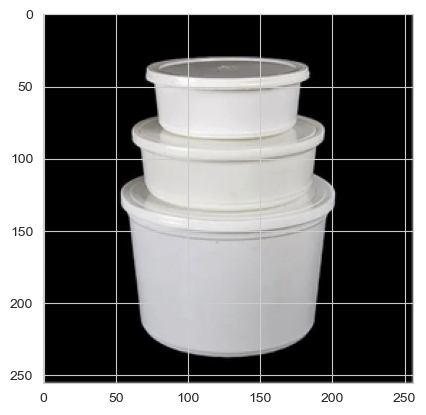

Paper


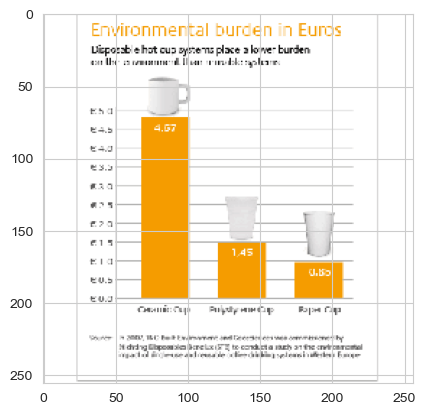

Other


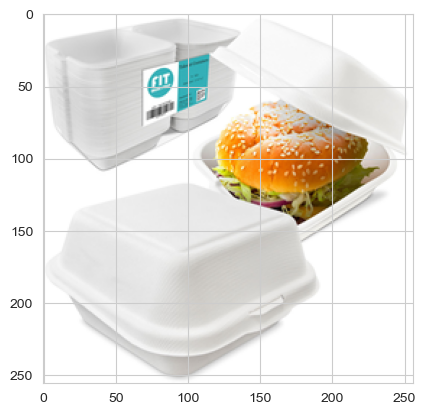

Plastic


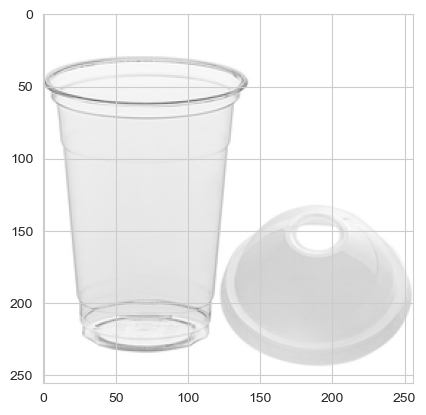

Cardboard


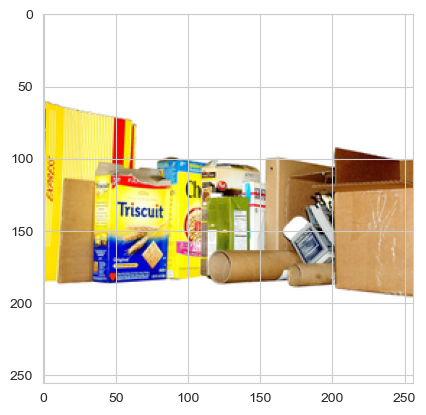

Plastic


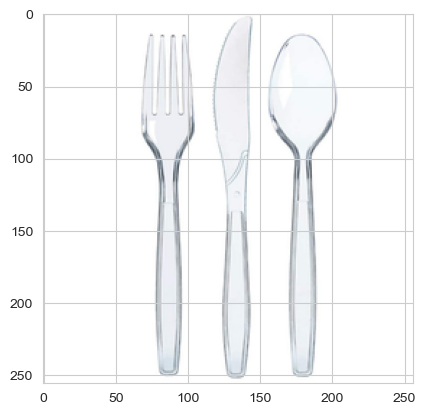

Cardboard


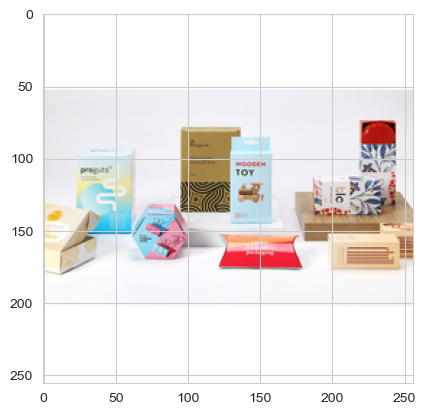

Cardboard


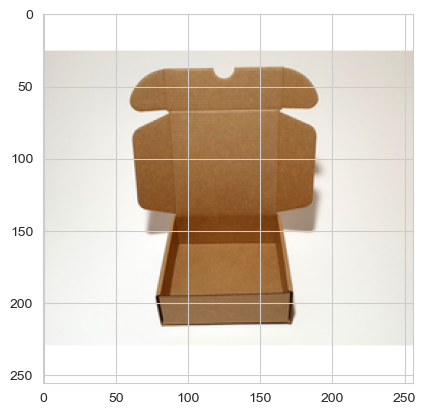

Food_Waste


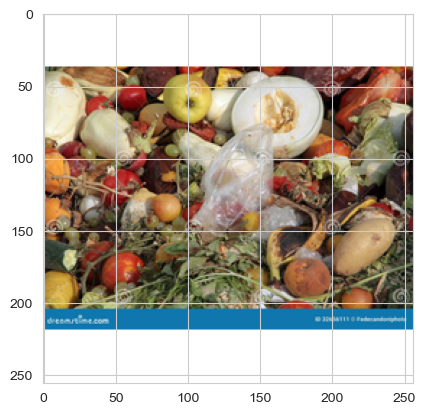

Paper


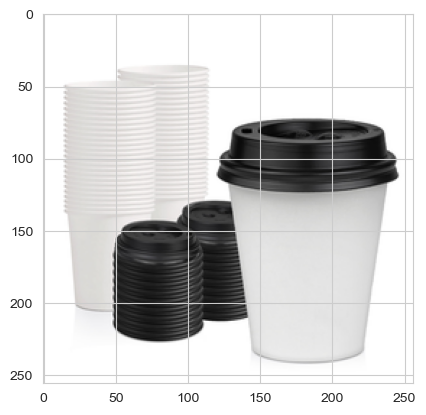

Paper


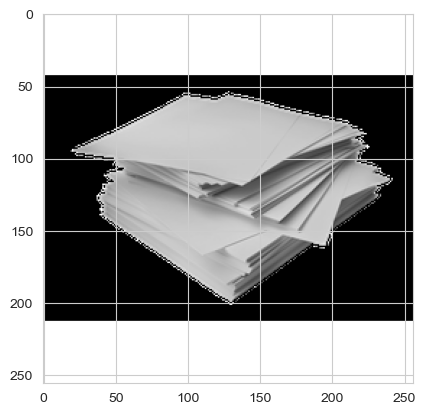

Glass


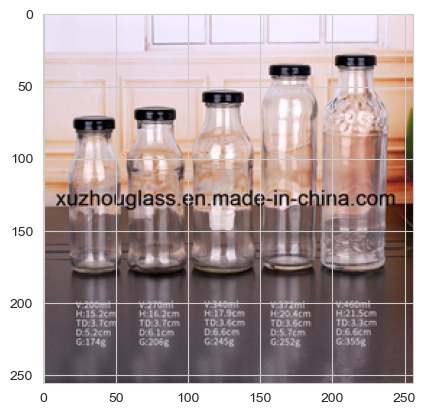

Plastic


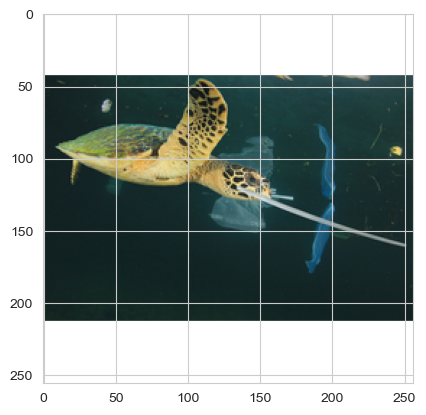

Plastic


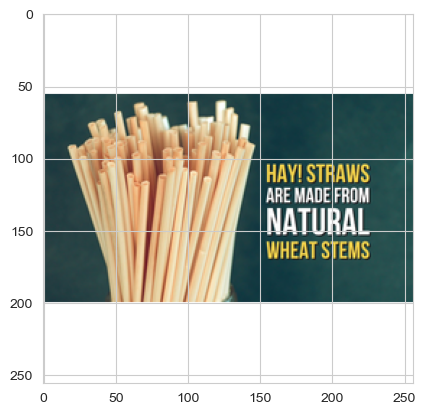

Food_Waste


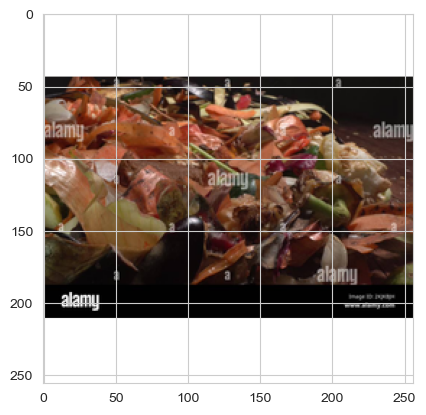

Other


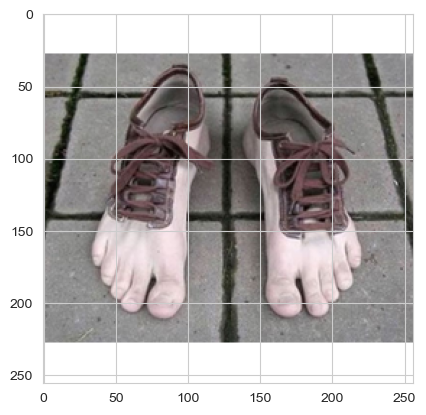

Plastic


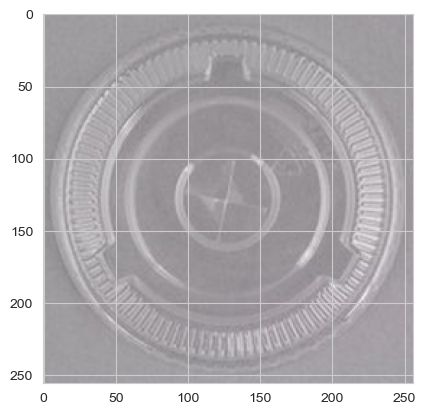

Food_Waste


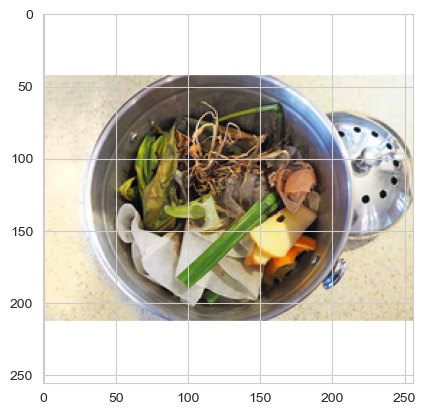

Plastic


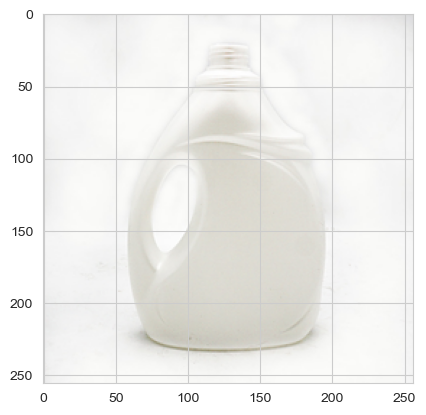

Other


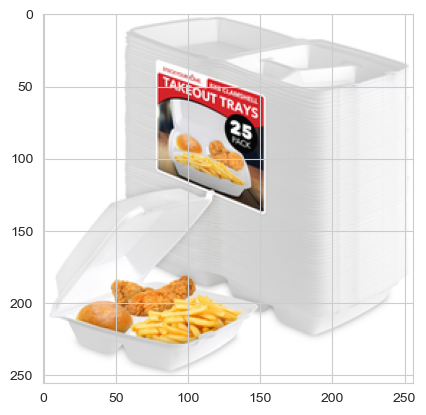

Paper


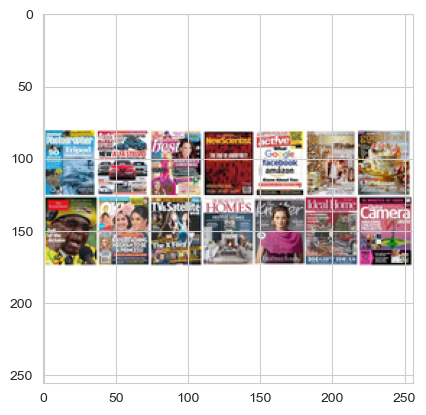

Metal


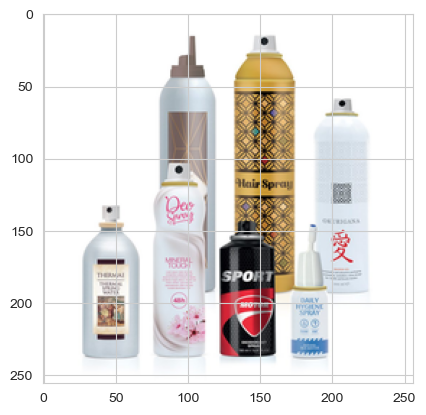

Metal


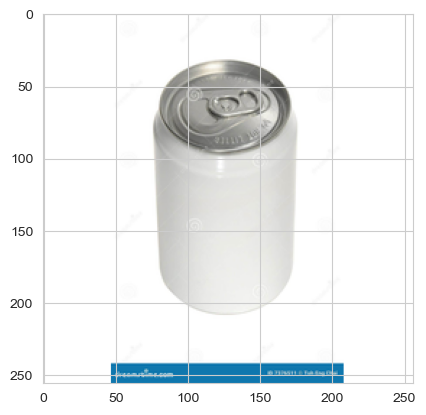

Plastic


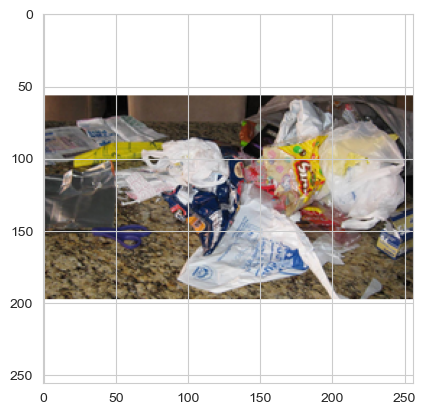

Metal


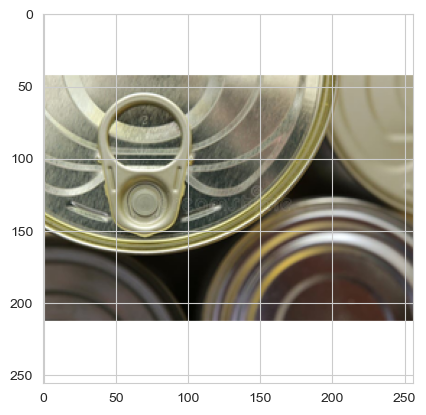

Cardboard


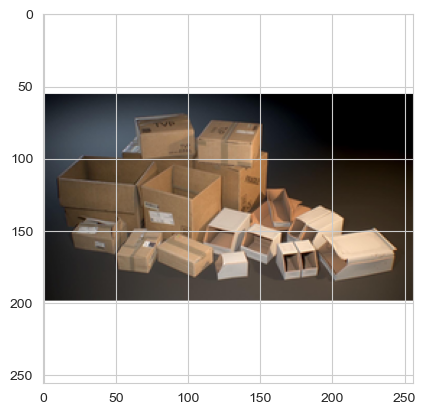

Plastic


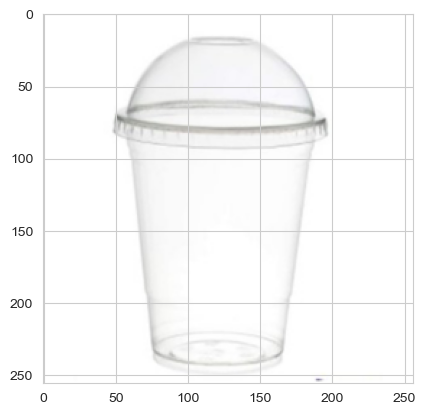

Glass


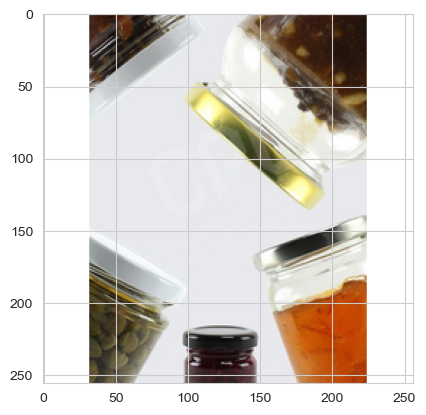

Food_Waste


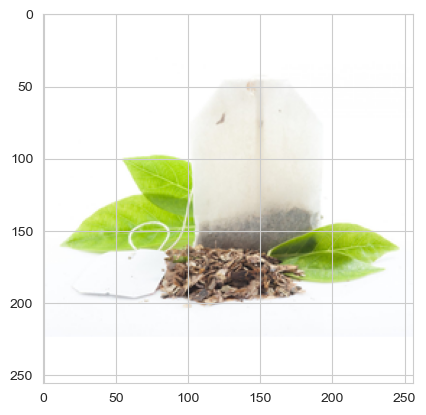

Plastic


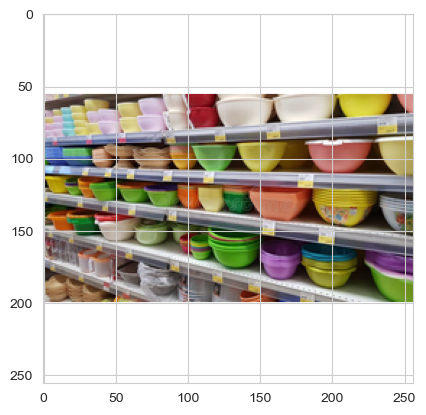

Metal


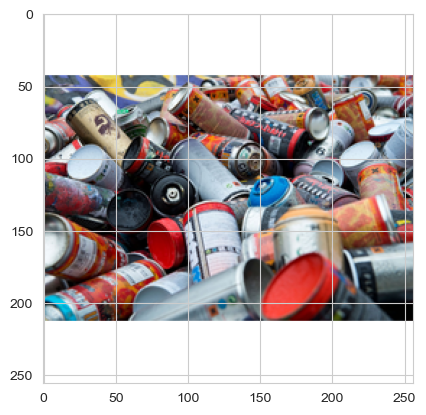

Plastic


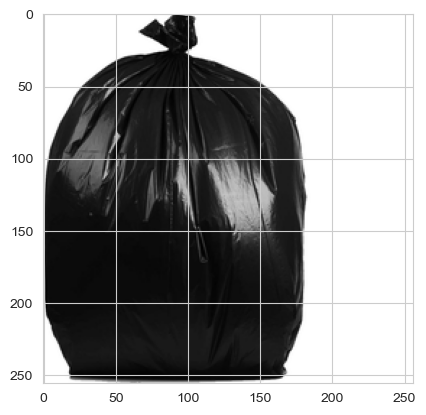

Paper


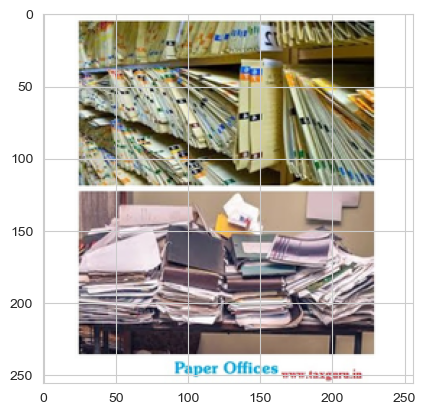

Plastic


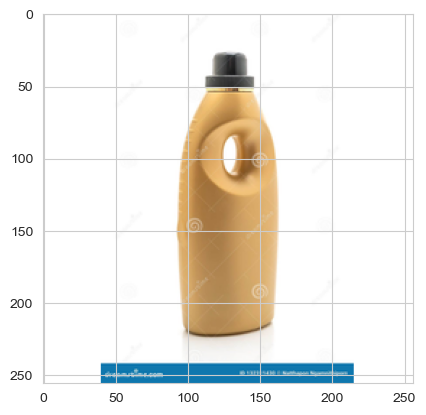

Metal


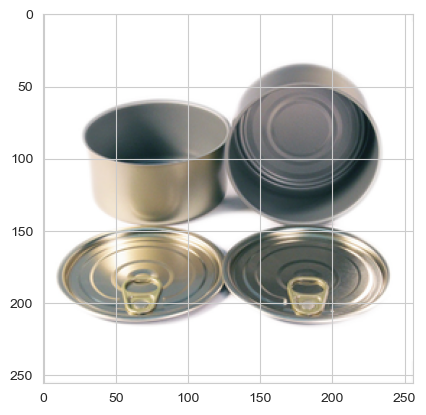

Metal


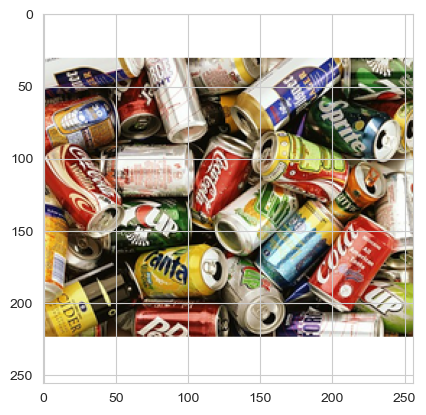

Other


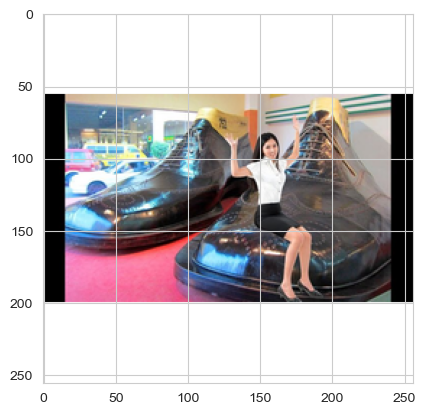

Cardboard


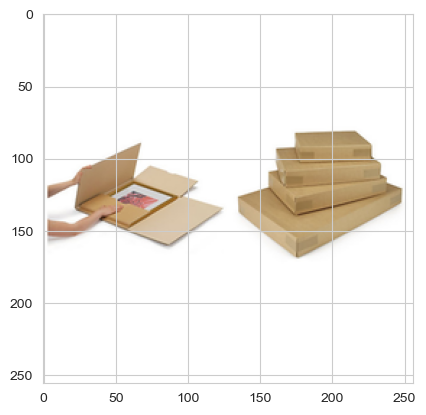

Glass


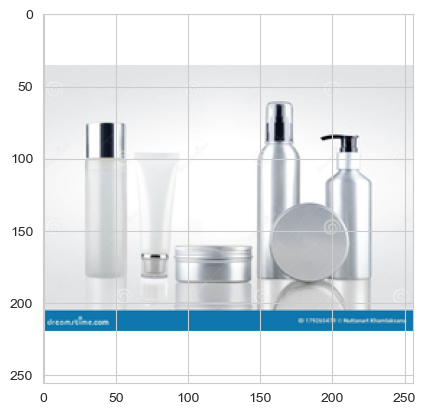

Paper


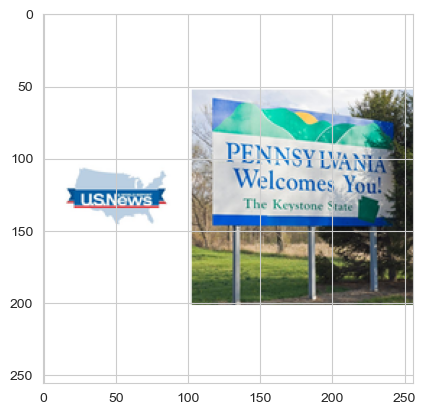

Food_Waste


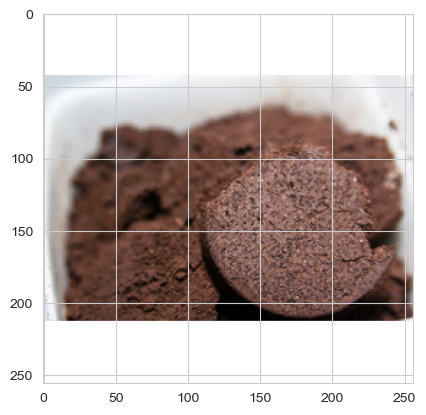

Food_Waste


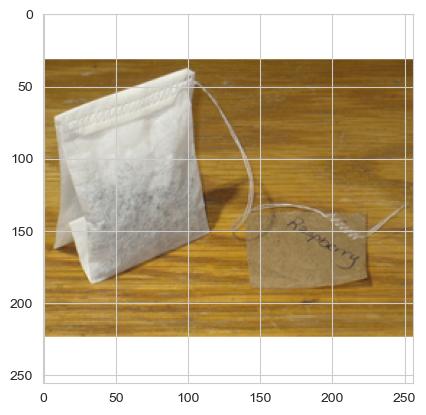

Glass


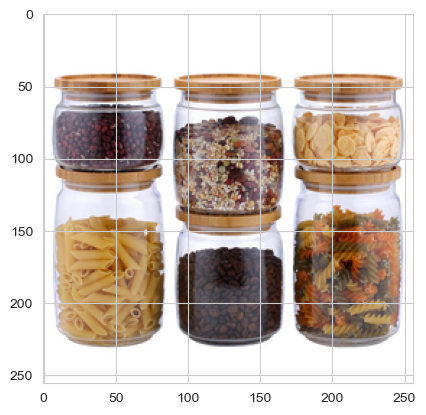

Metal


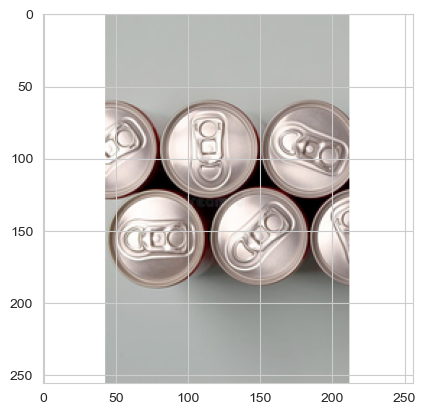

Food_Waste


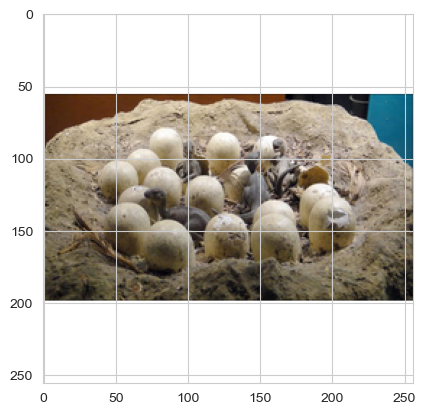

Metal


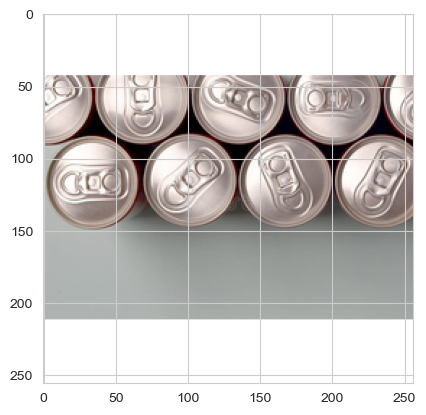

Food_Waste


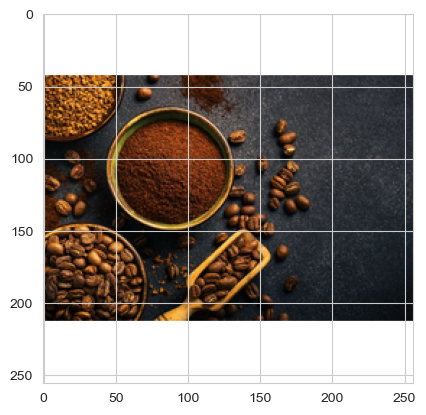

Glass


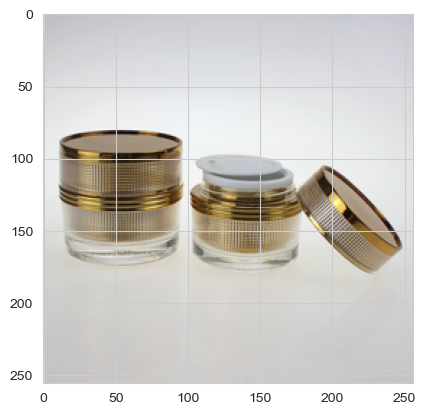

Plastic


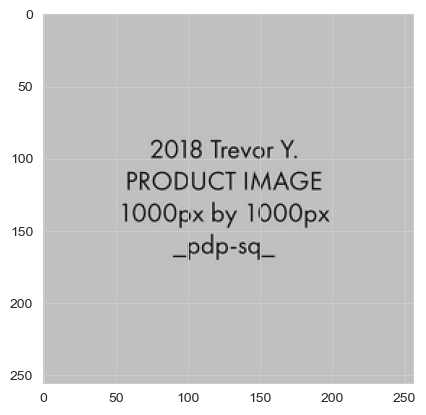

Other


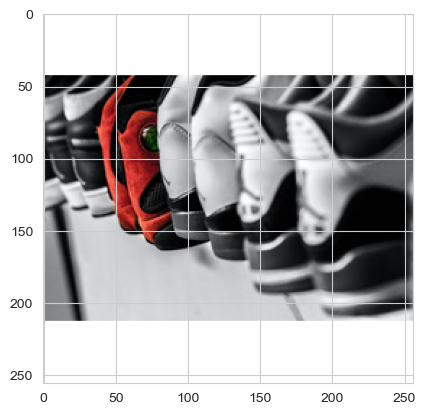

Food_Waste


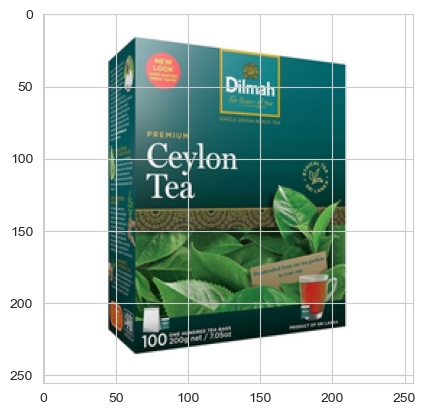

Food_Waste


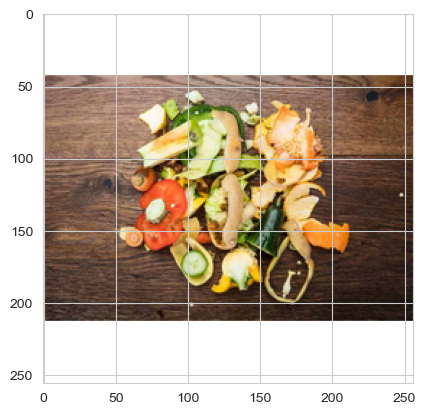

Plastic


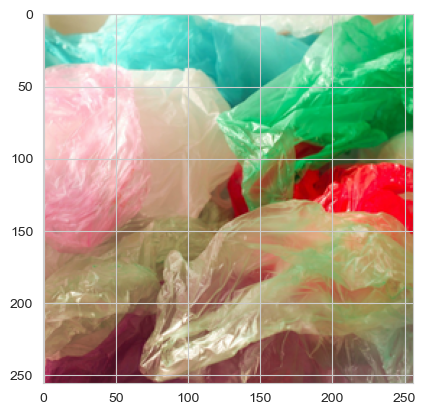

Food_Waste


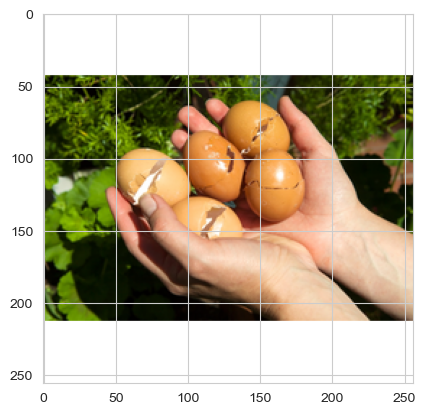

Plastic


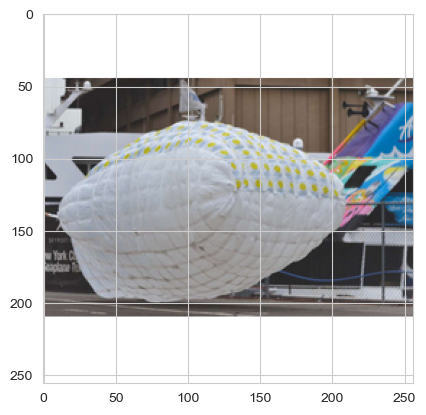

Plastic


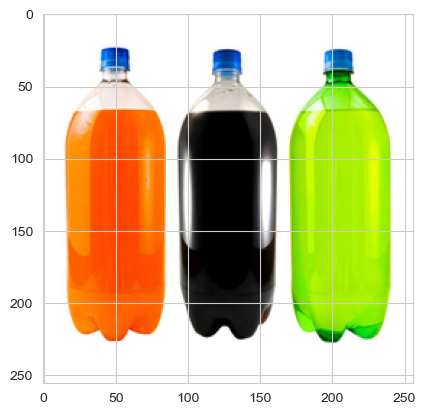

Paper


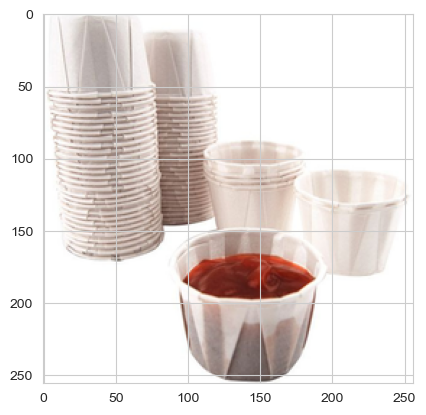

Plastic


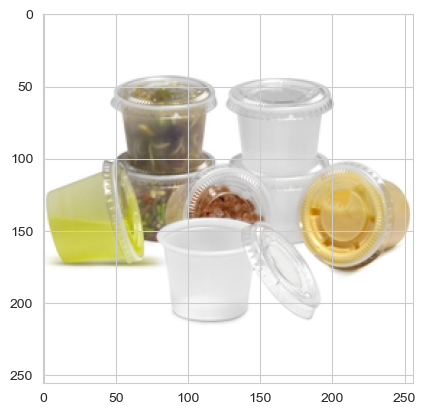

Other


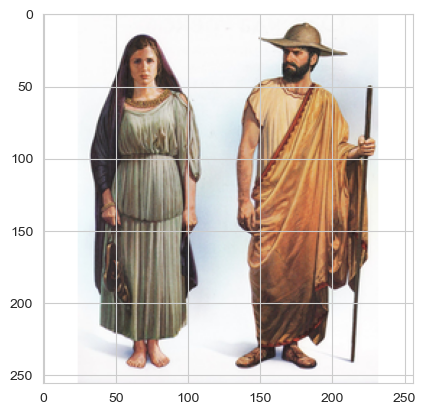

Metal


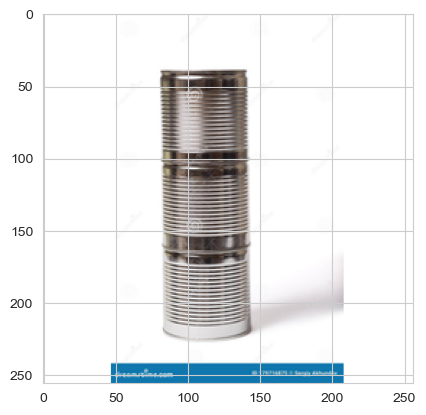

Cardboard


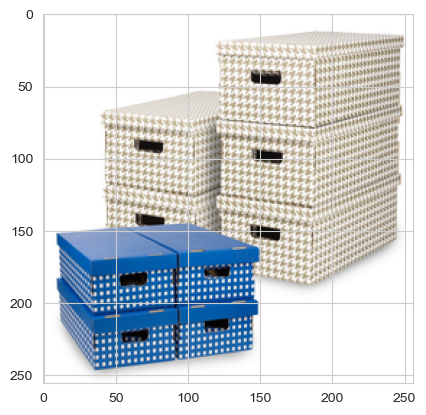

Other


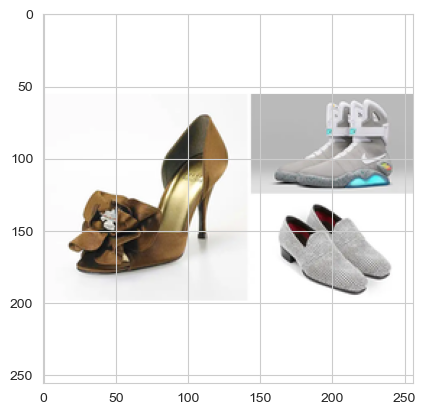

Food_Waste


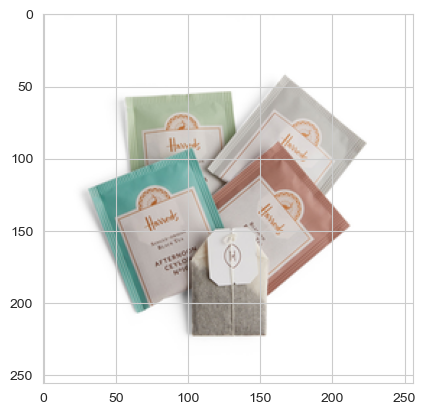

Plastic


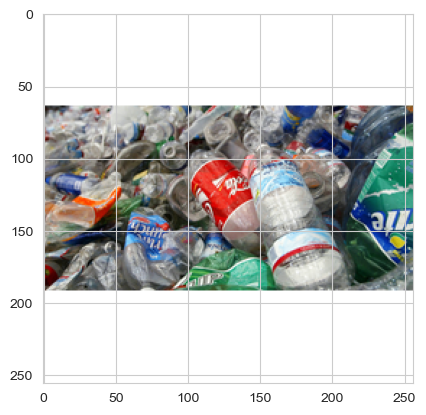

Plastic


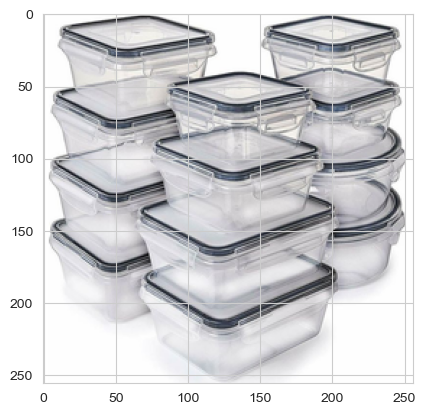

Plastic


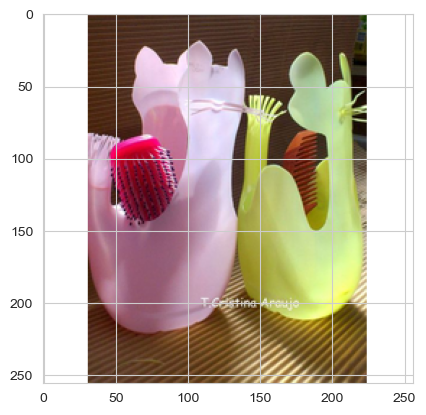

Metal


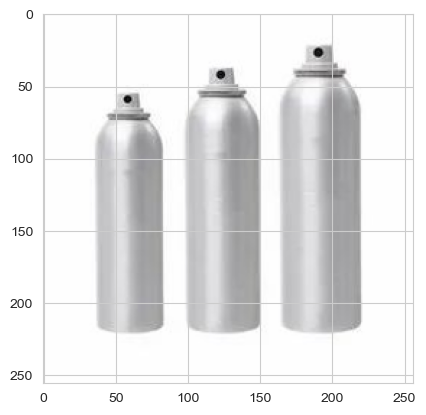

Food_Waste


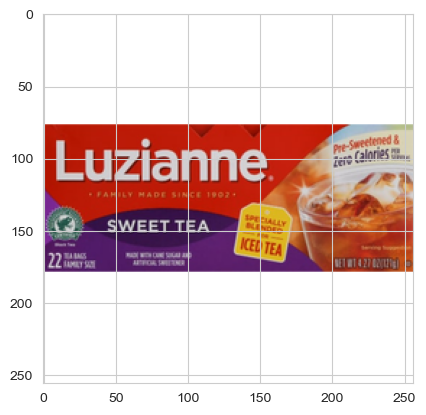

Plastic


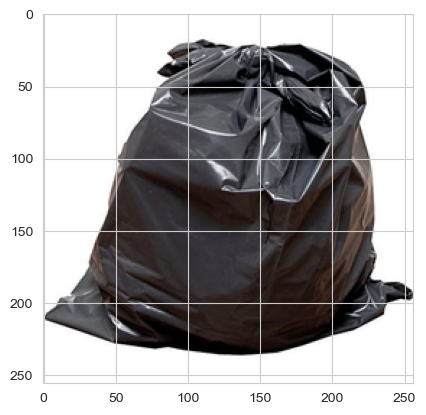

Food_Waste


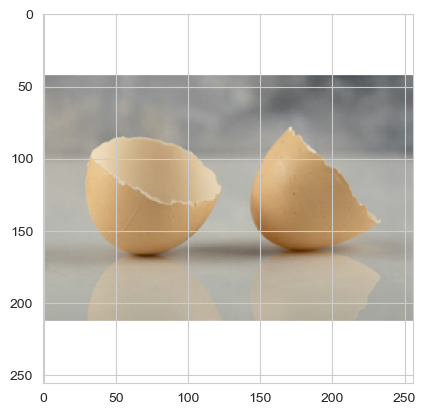

Plastic


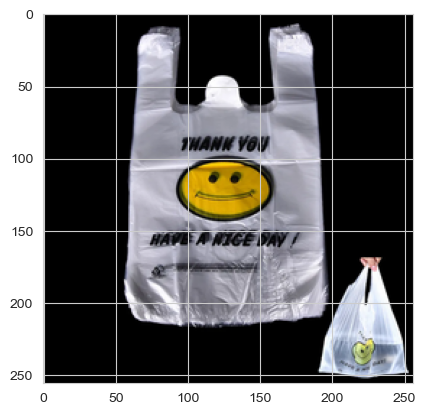

Glass


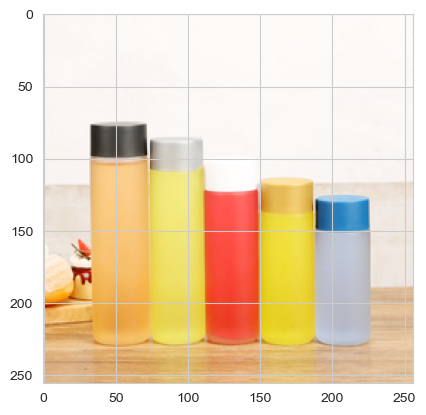

Plastic


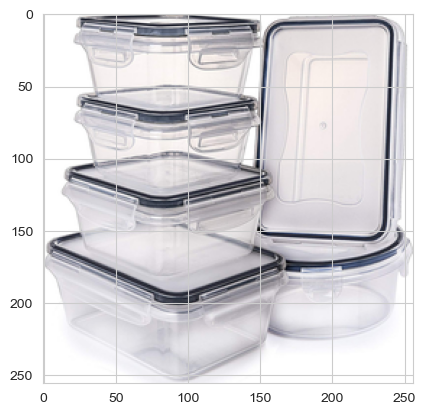

Other


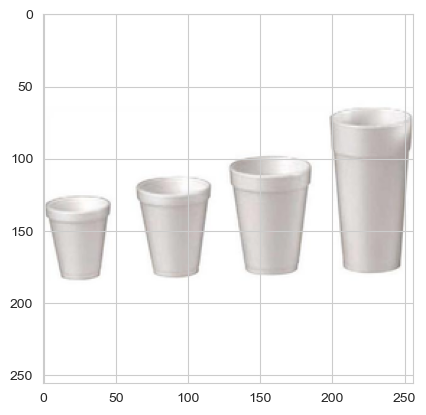

Metal


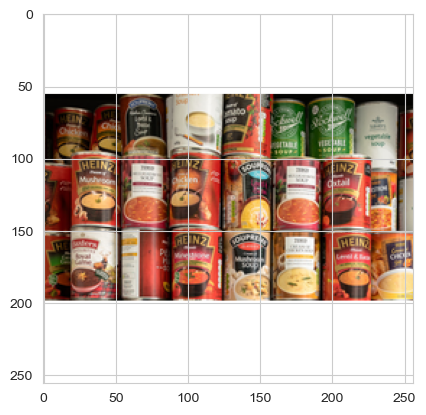

Paper


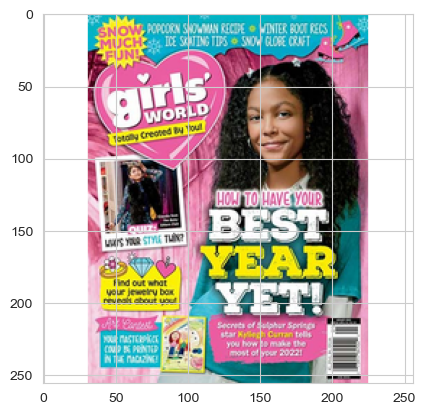

Food_Waste


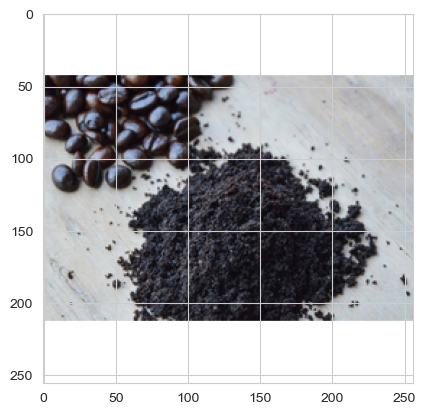

Plastic


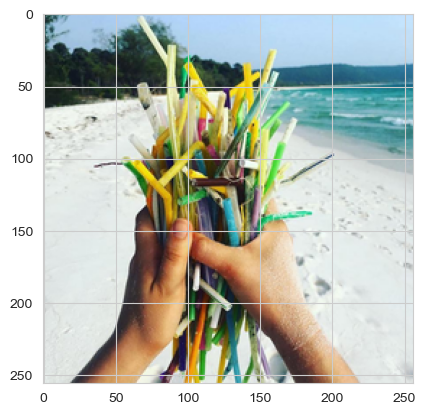

Paper


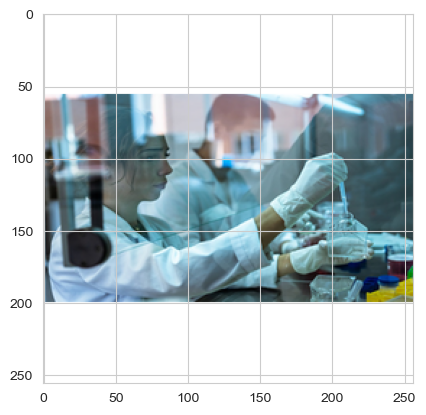

Glass


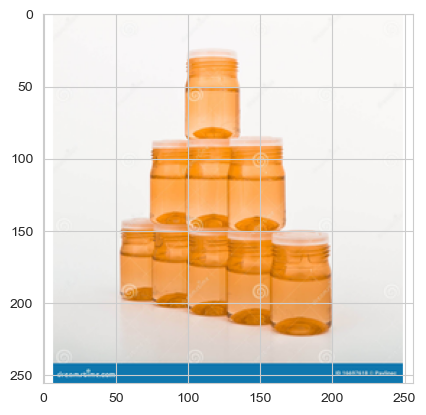

Plastic


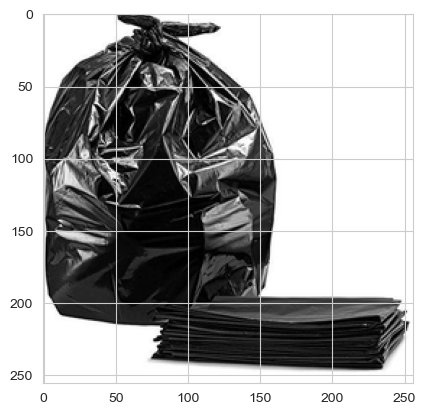

Cardboard


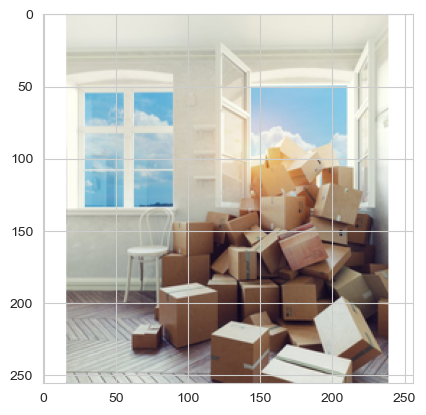

Other


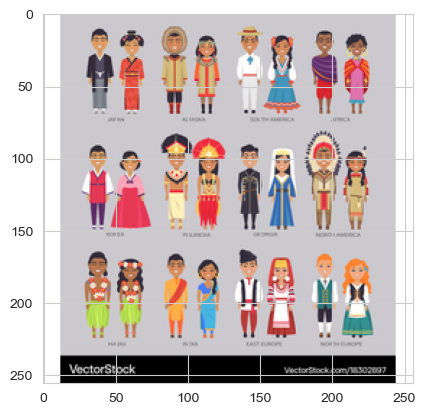

Metal


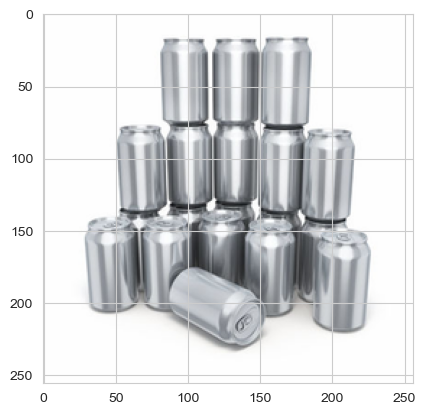

Plastic


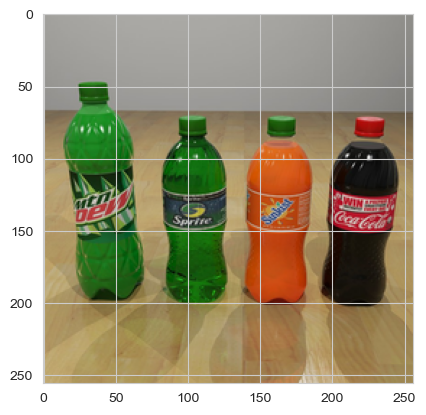

Paper


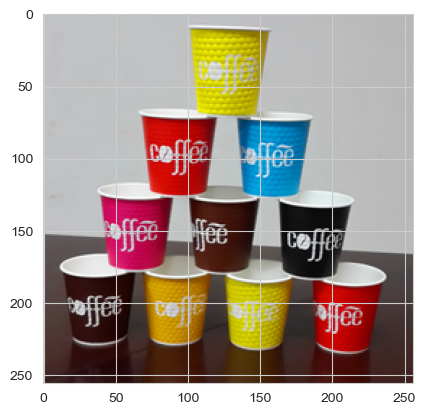

Paper


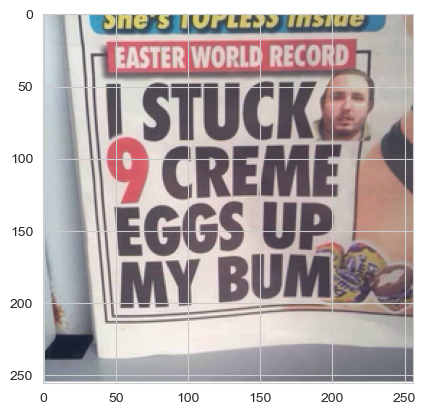

Glass


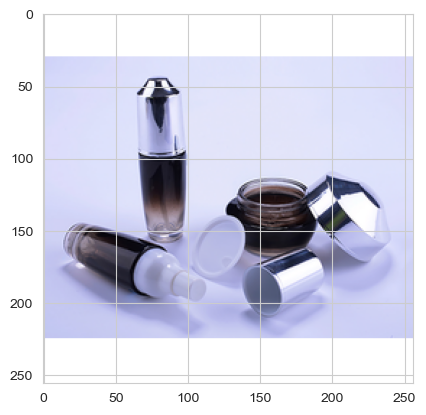

Paper


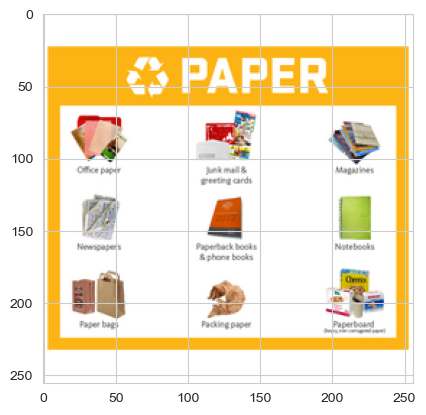

Cardboard


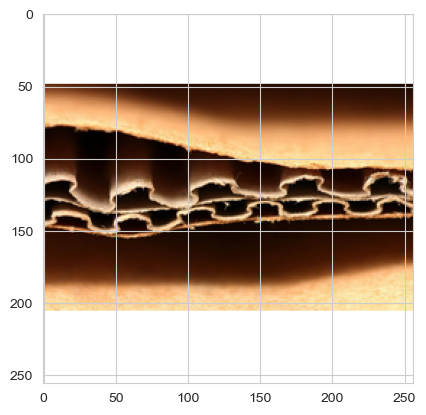

Glass


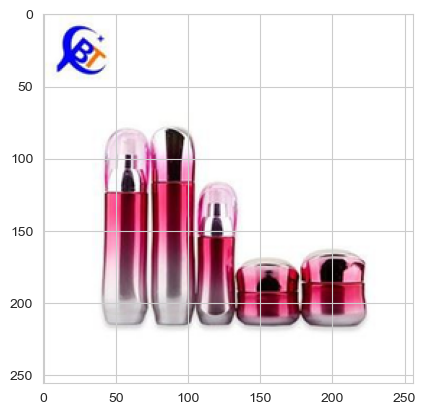

Plastic


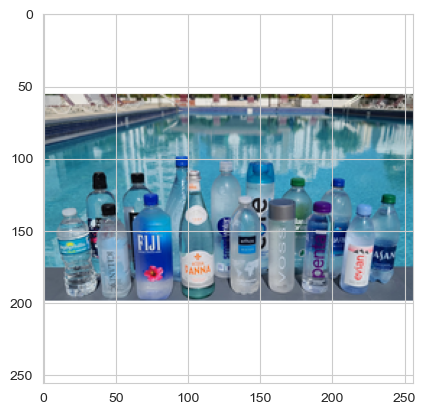

Other


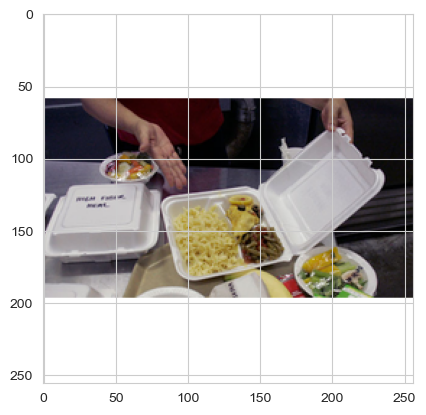

Plastic


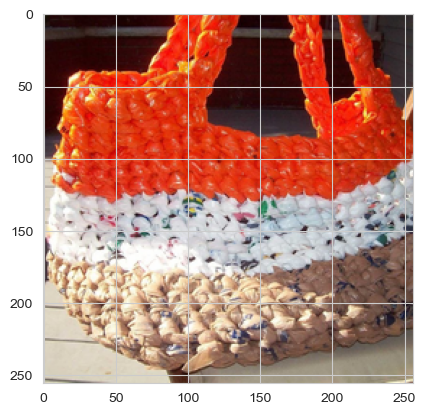

Plastic


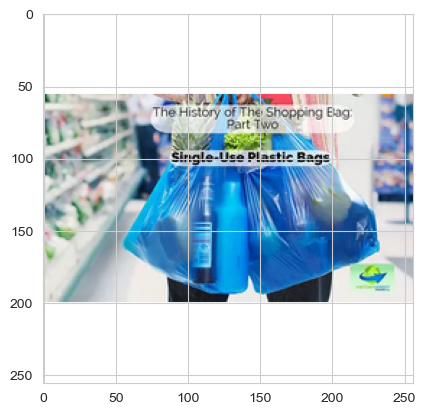

Glass


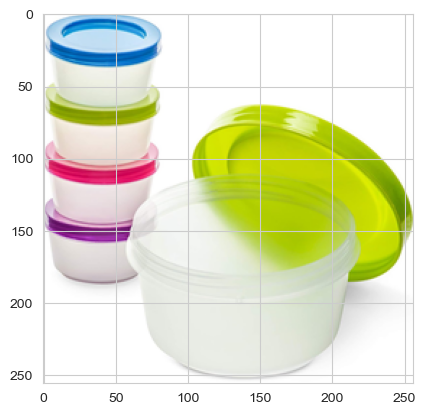

Plastic


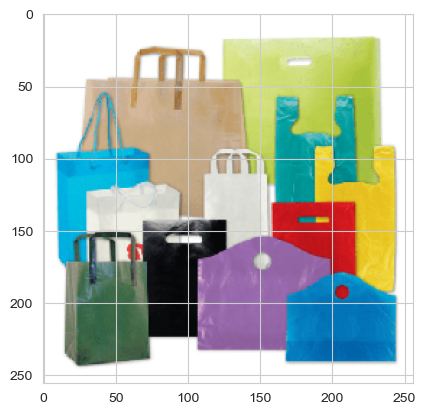

Food_Waste


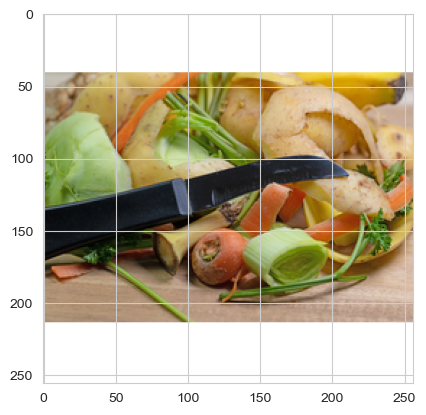

Other


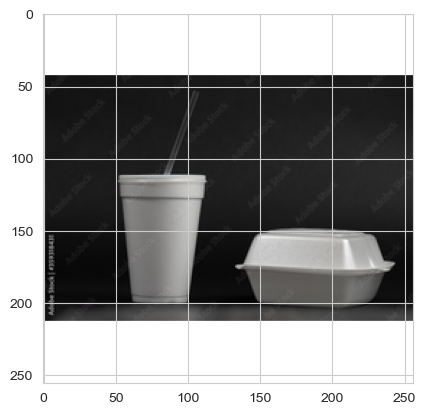

Paper


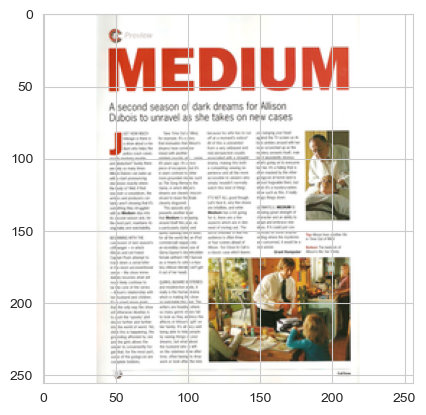

Metal


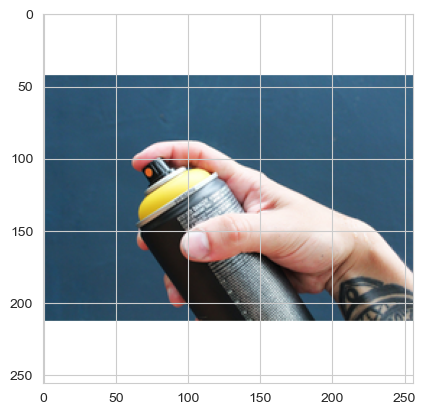

Plastic


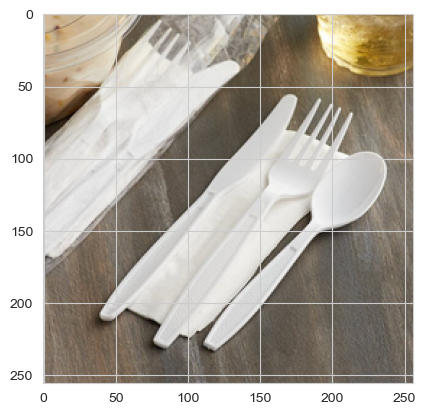

Plastic


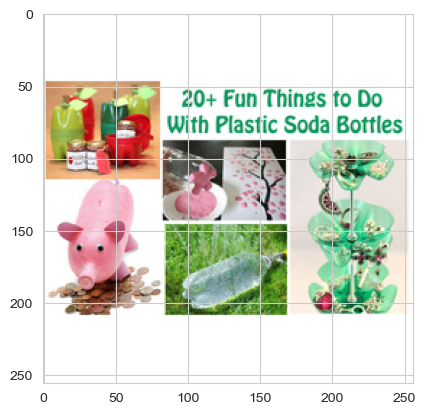

Other


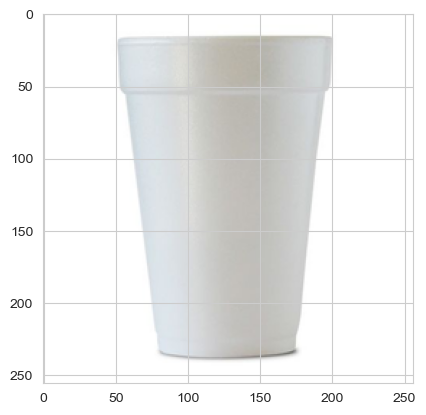

Cardboard


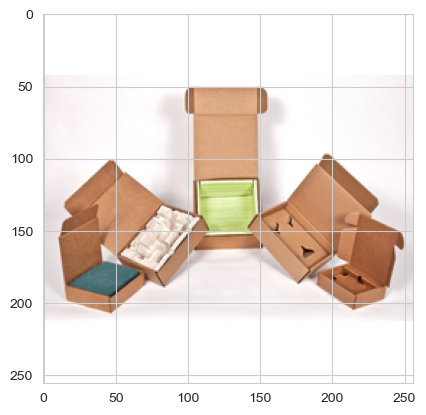

Cardboard


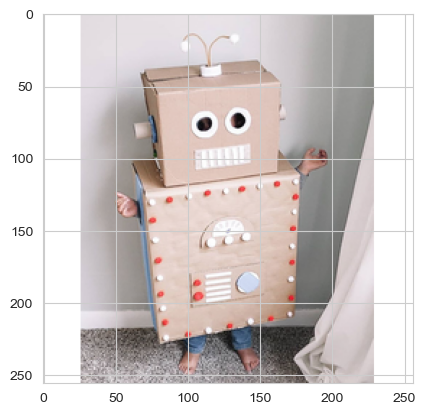

Plastic


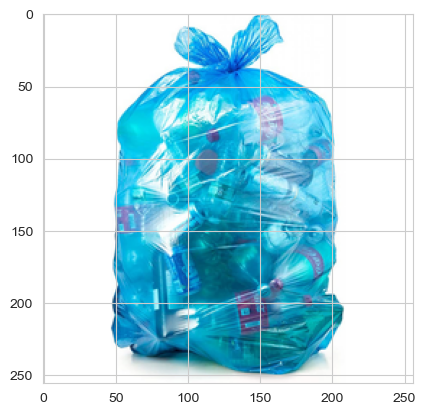

Food_Waste


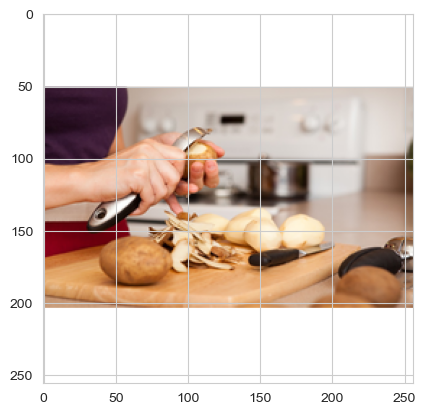

Food_Waste


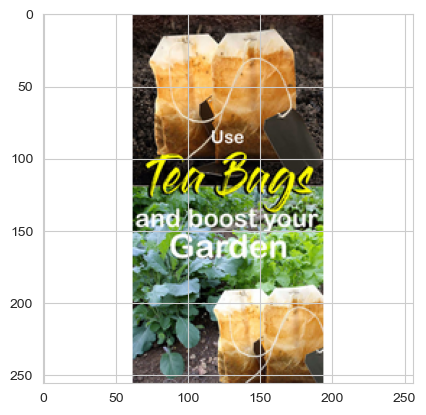

Metal


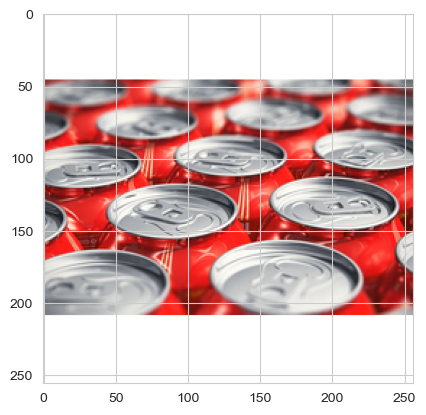

Food_Waste


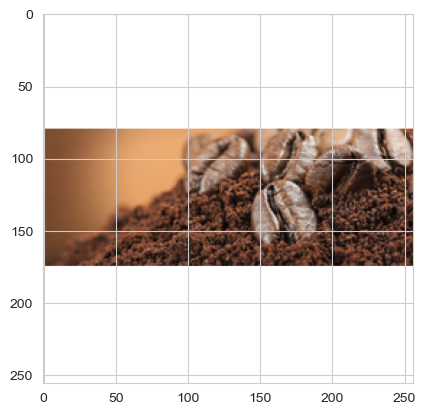

Plastic


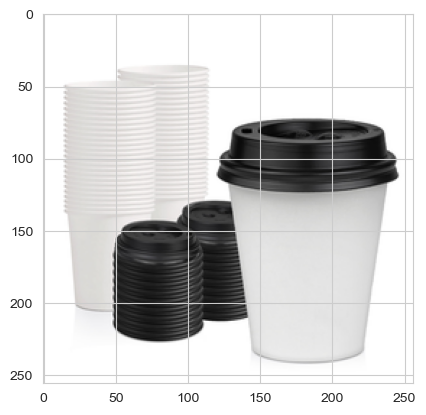

Food_Waste


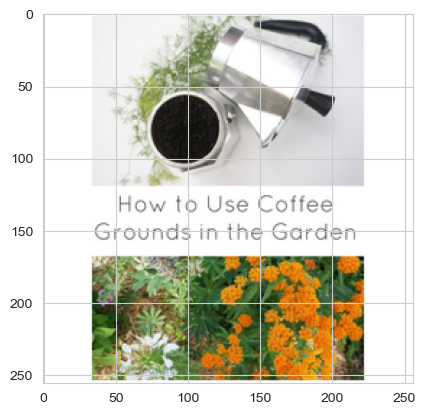

Other


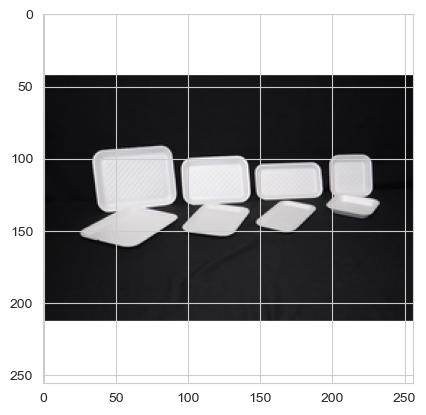

Other


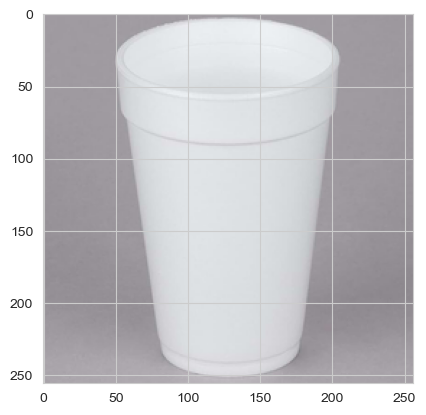

Paper


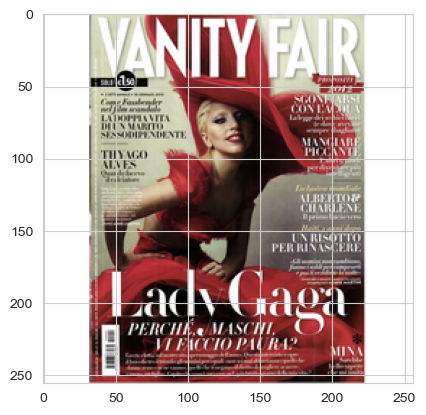

Glass


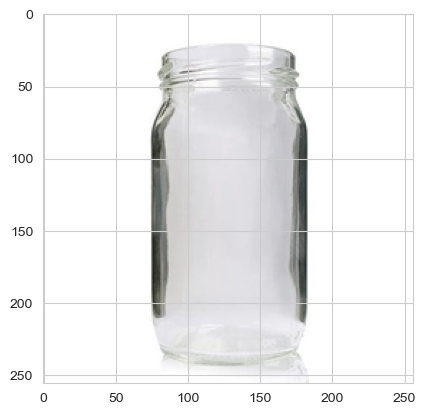

Metal


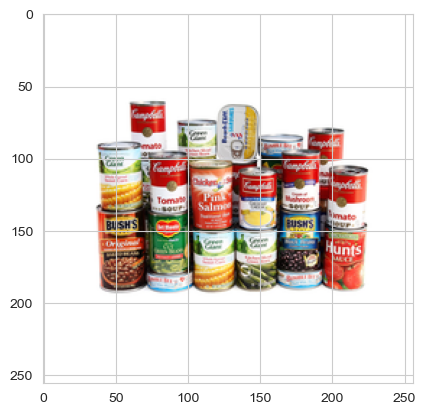

Metal


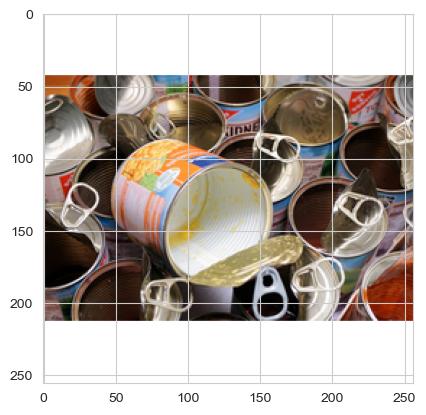

Metal


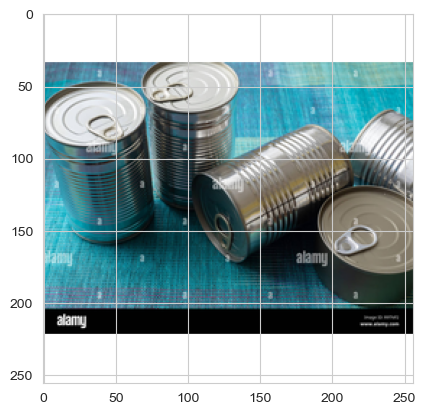

Paper


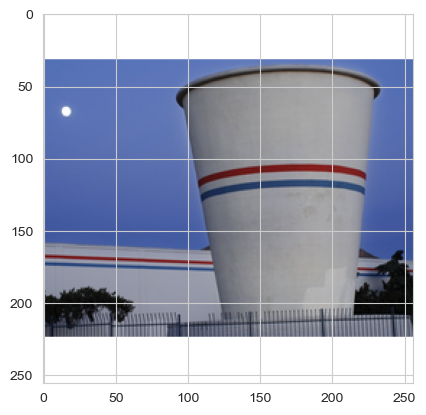

Metal


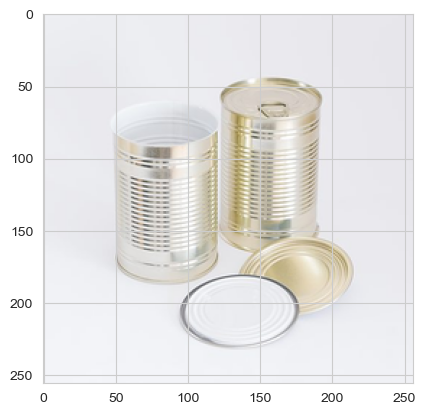

Plastic


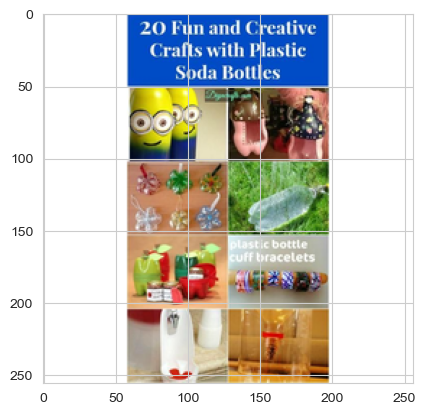

Plastic


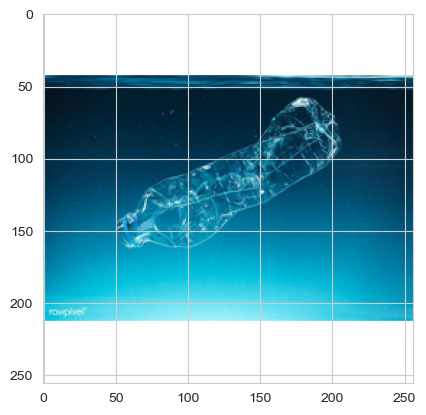

Metal


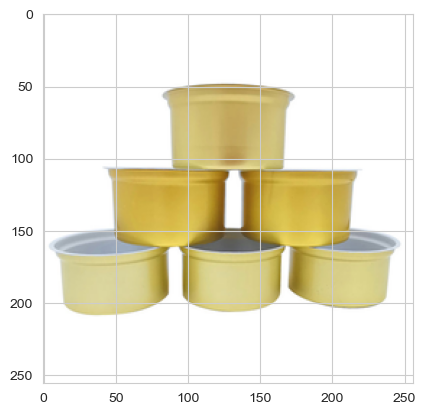

Cardboard


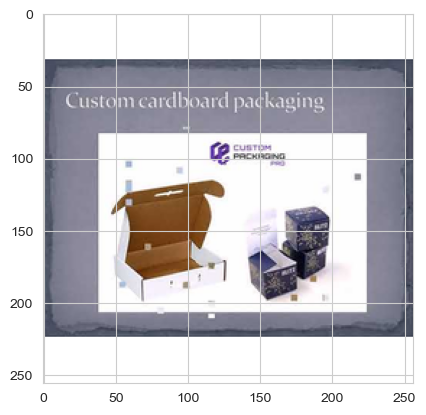

Food_Waste


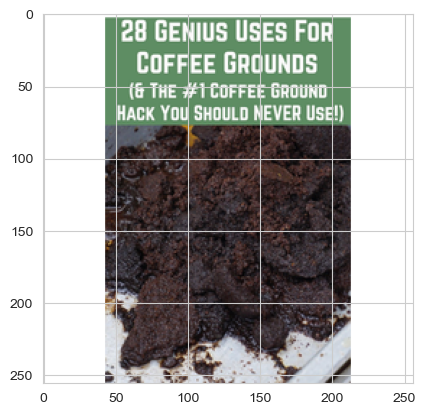

Plastic


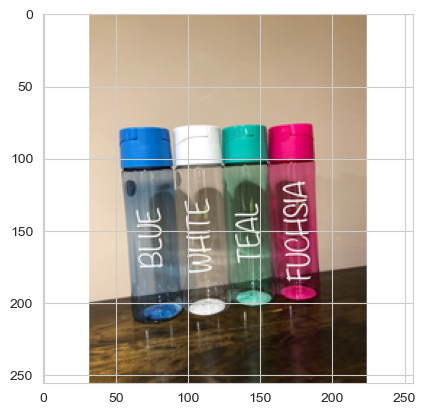

Plastic


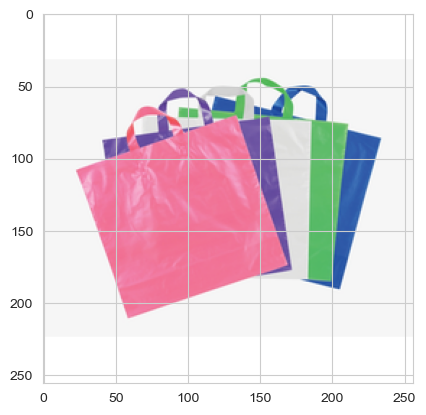

Plastic


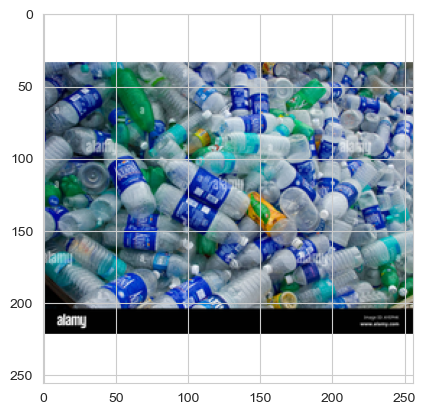

Food_Waste


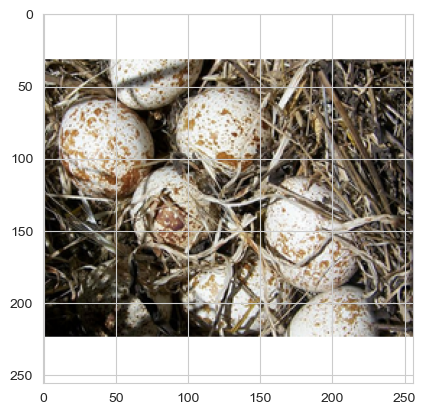

Other


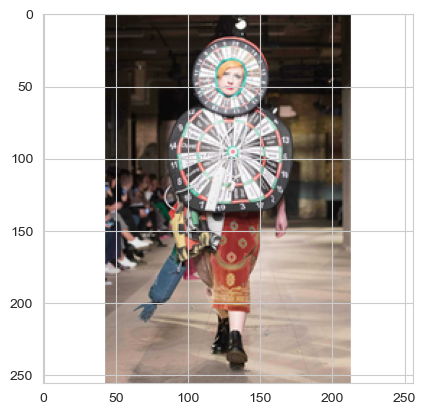

Paper


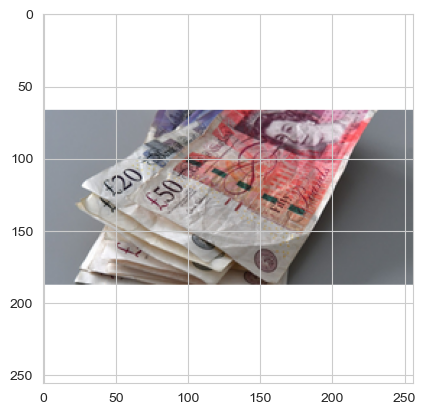

Plastic


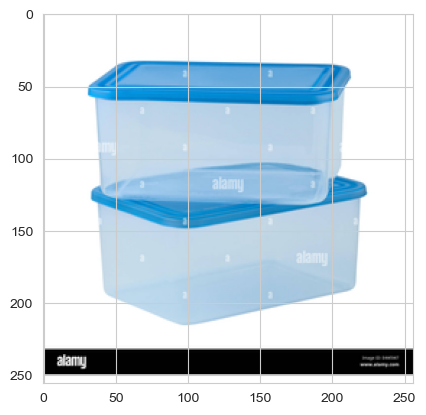

Metal


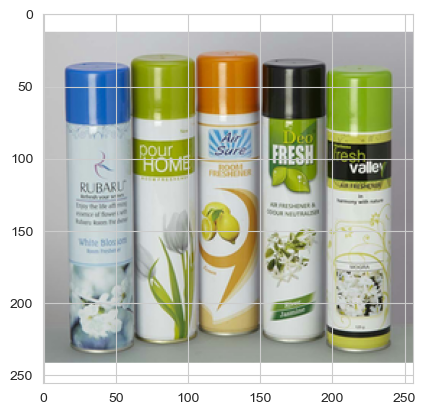

Plastic


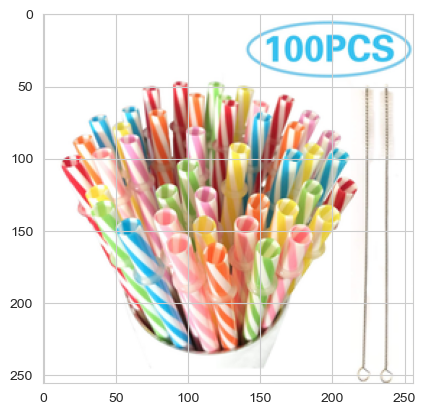

Metal


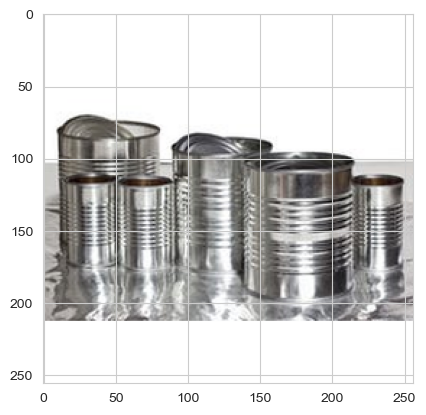

Cardboard


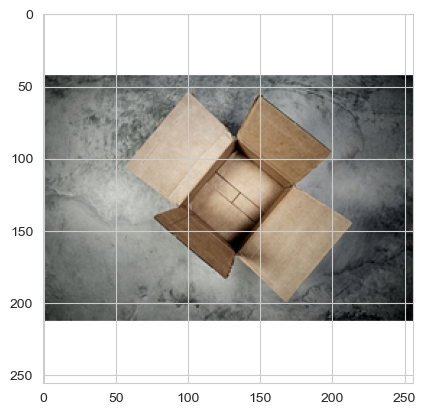

Other


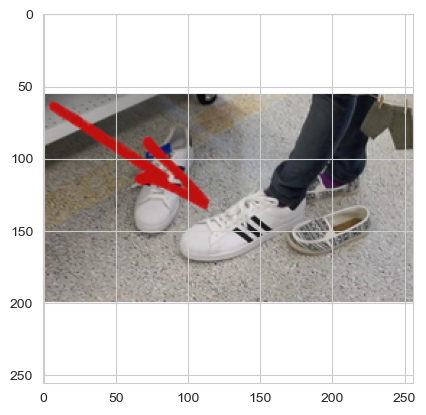

Cardboard


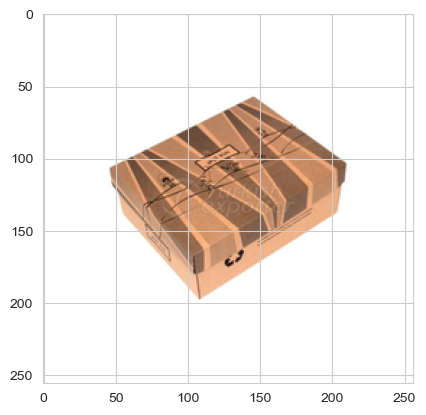

Food_Waste


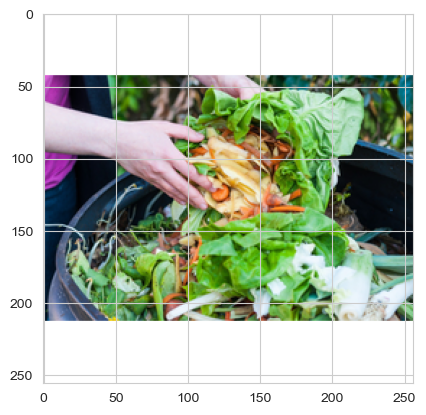

Paper


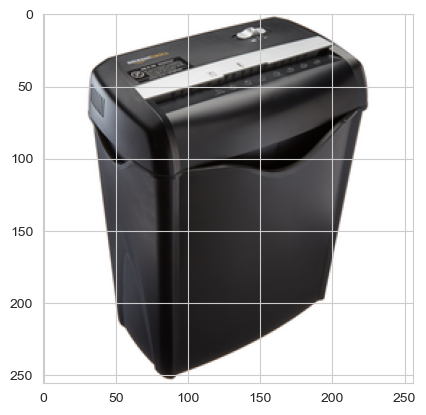

Other


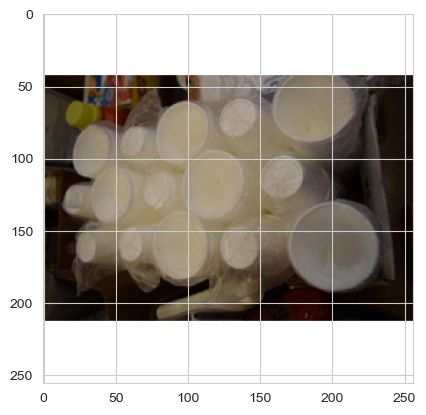

Cardboard


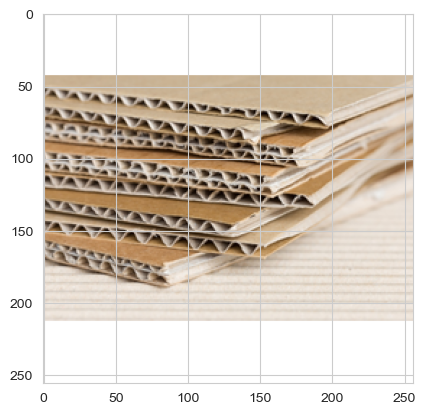

Other


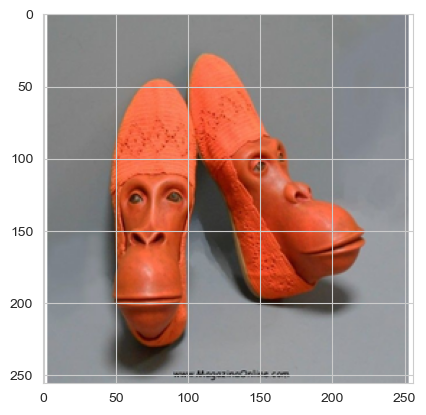

Paper


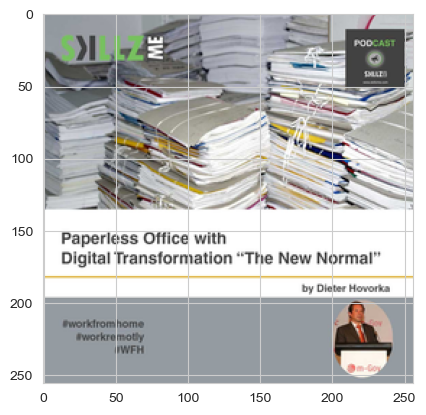

Metal


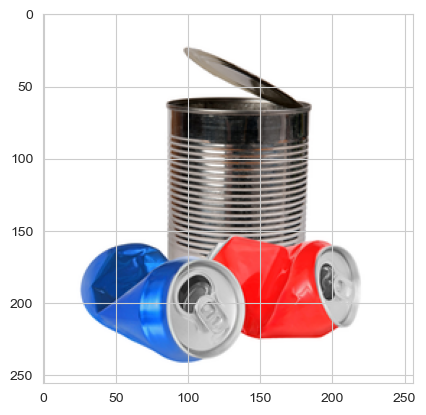

Cardboard


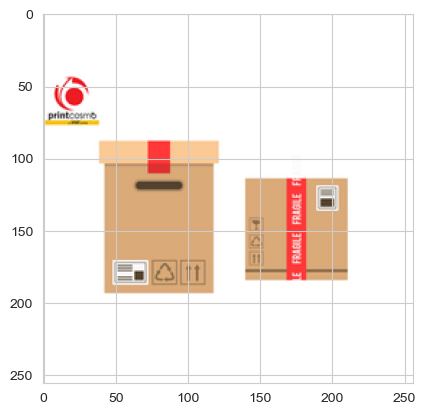

Paper


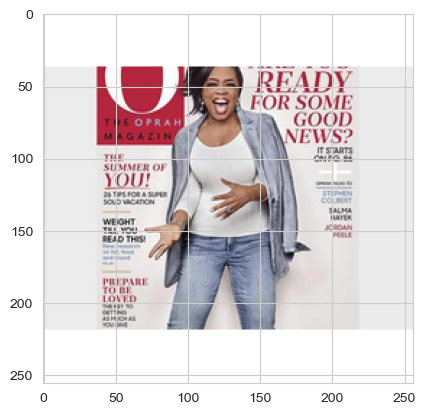

Cardboard


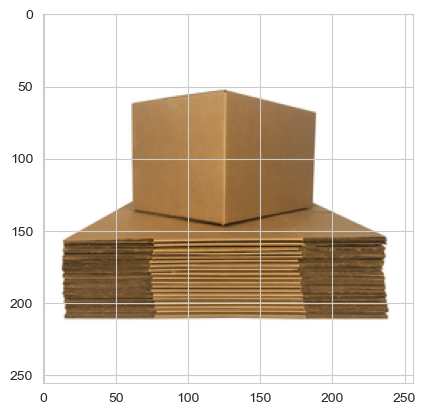

Plastic


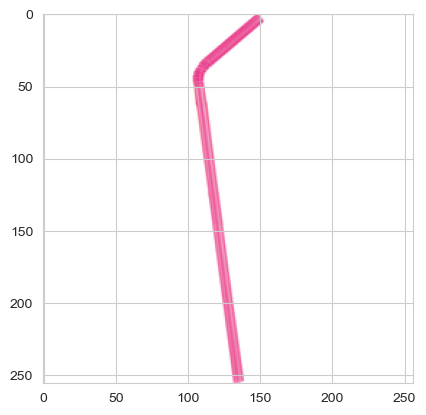

Paper


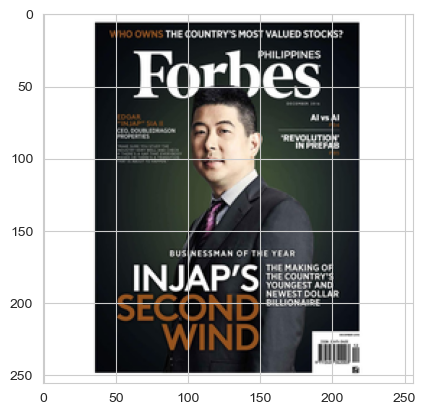

Plastic


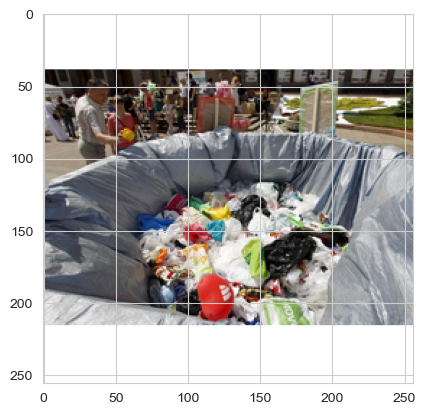

Plastic


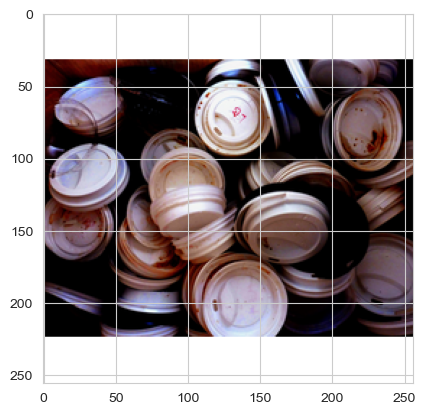

Plastic


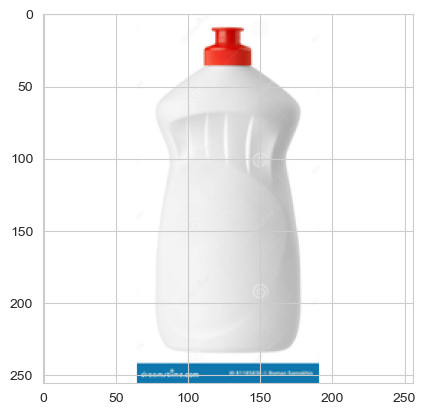

Plastic


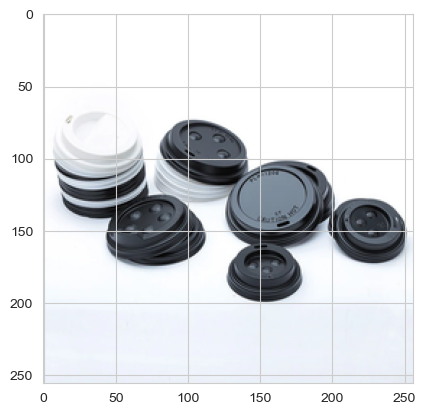

Metal


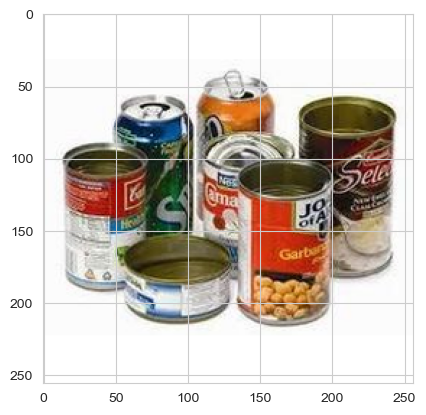

Plastic


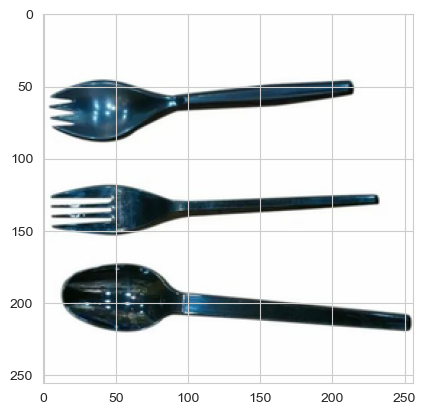

Plastic


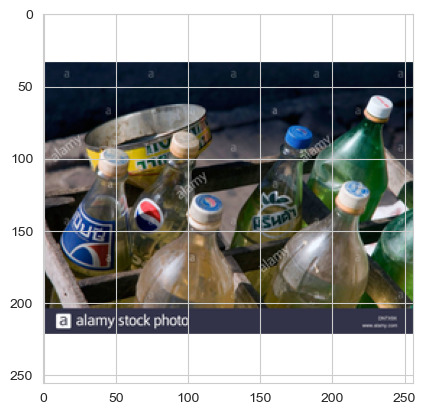

Other


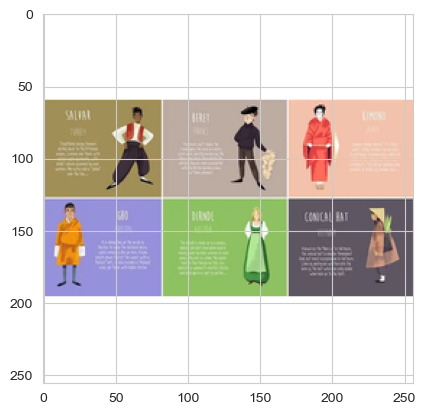

Food_Waste


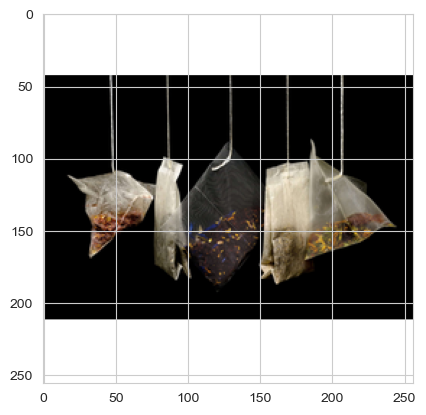

Paper


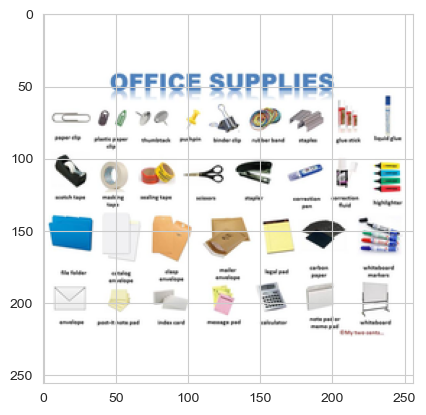

Cardboard


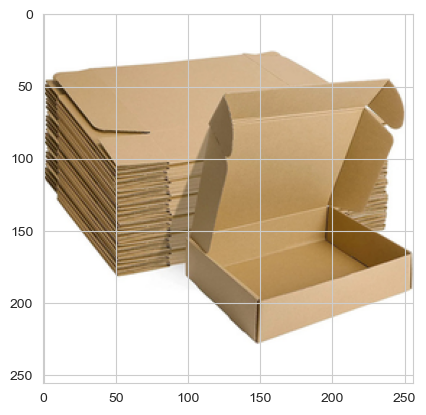

Metal


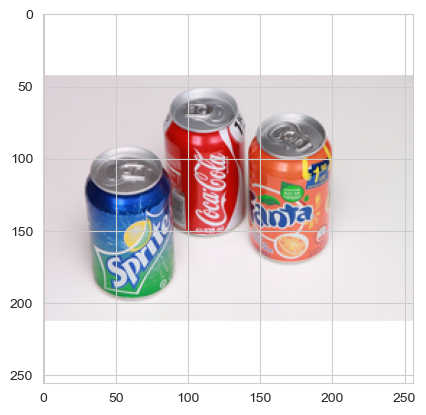

Plastic


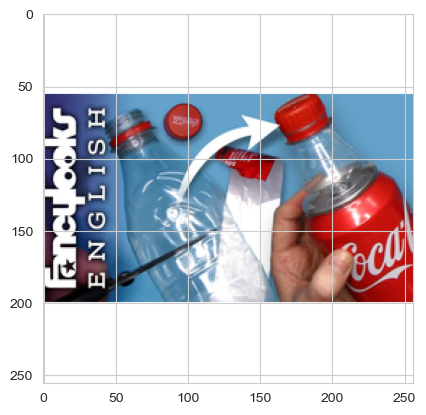

Plastic


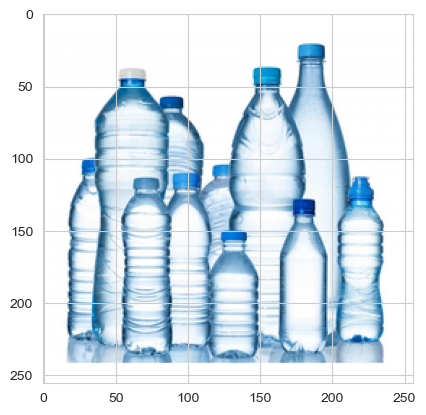

Food_Waste


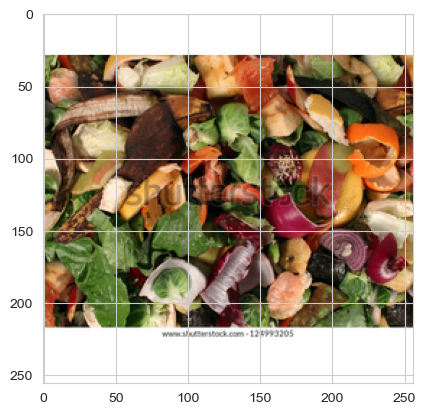

Plastic


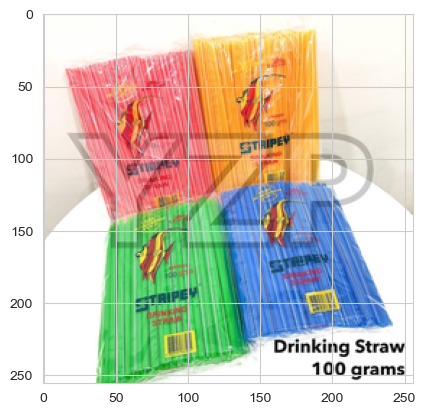

Cardboard


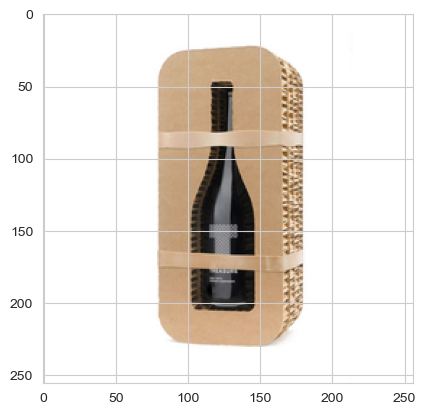

Food_Waste


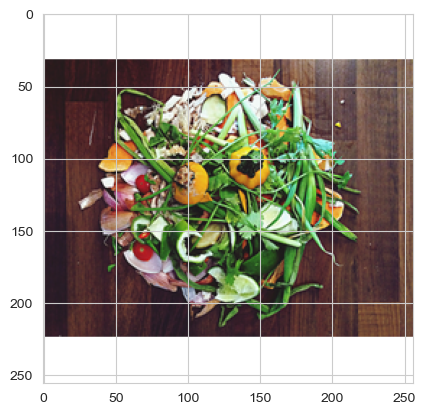

Cardboard


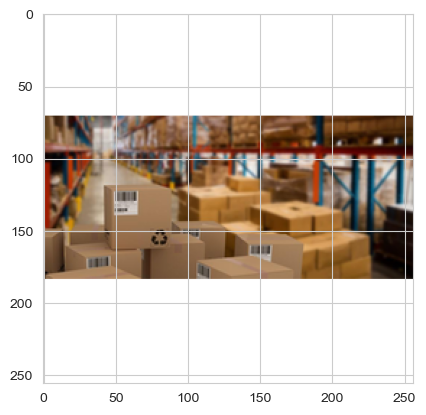

Paper


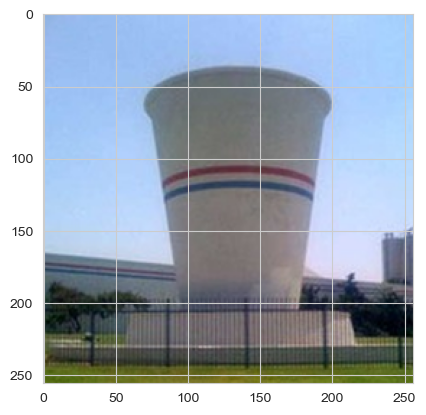

Paper


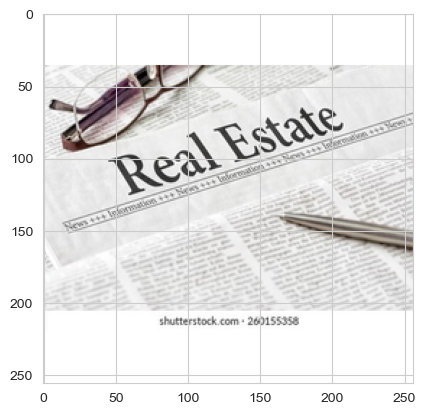

Paper


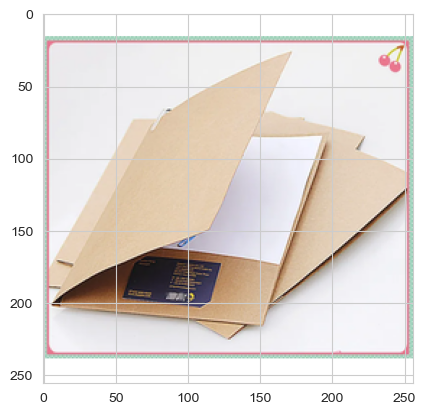

Metal


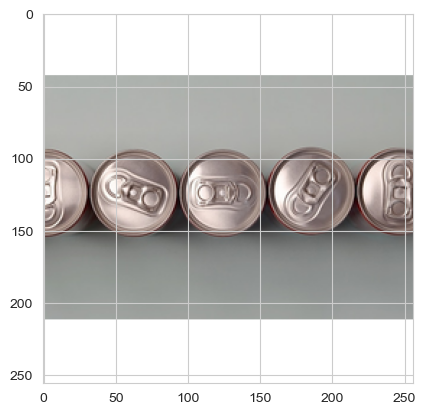

Paper


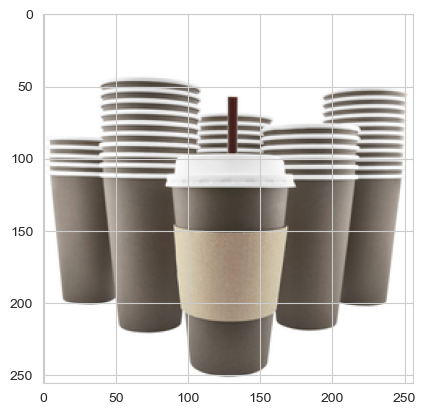

Other


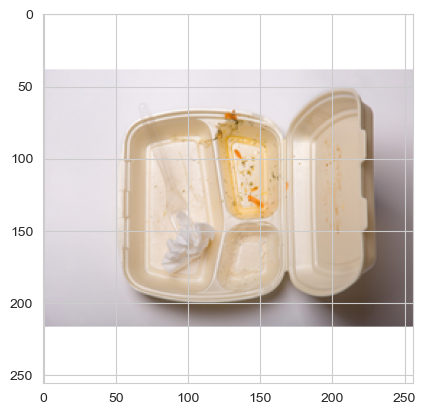

Paper


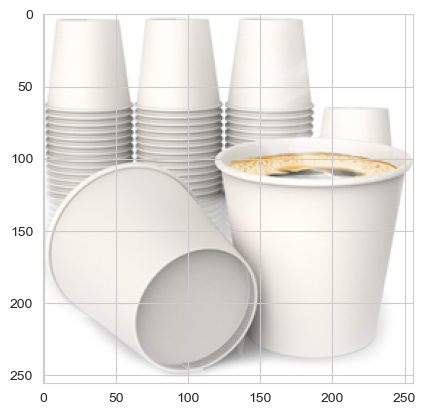

Paper


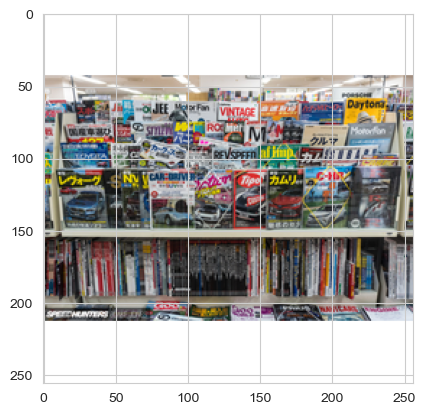

Metal


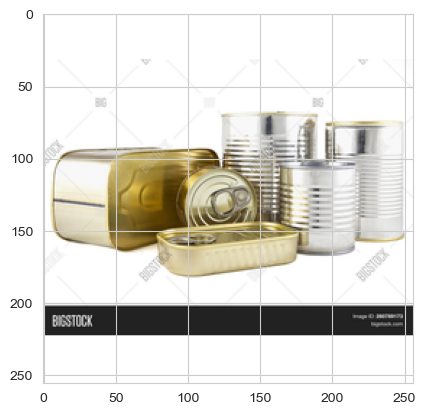

Other


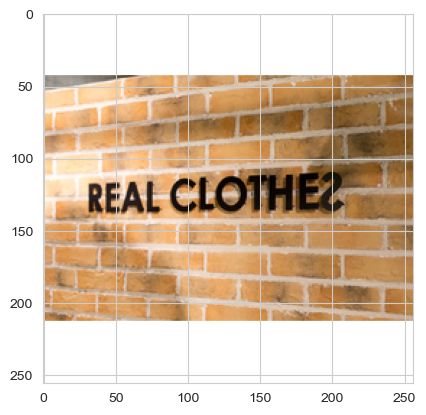

Other


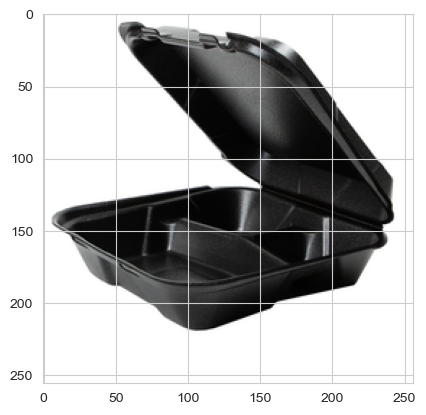

Other


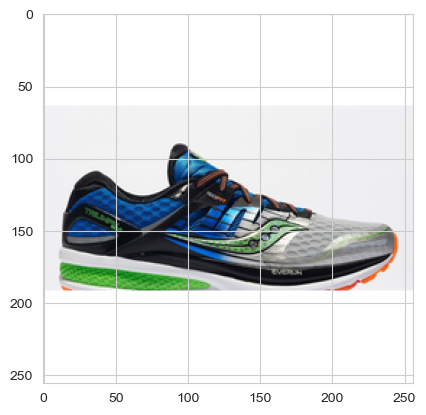

Paper


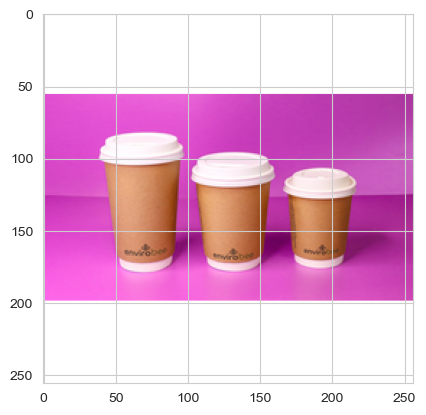

Metal


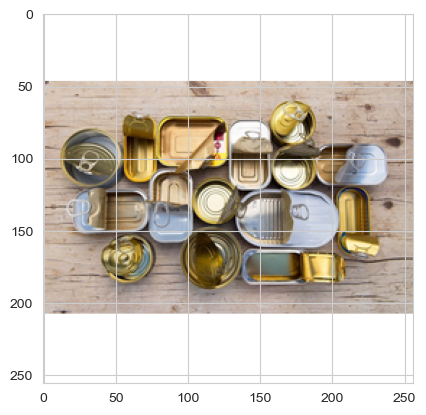

Metal


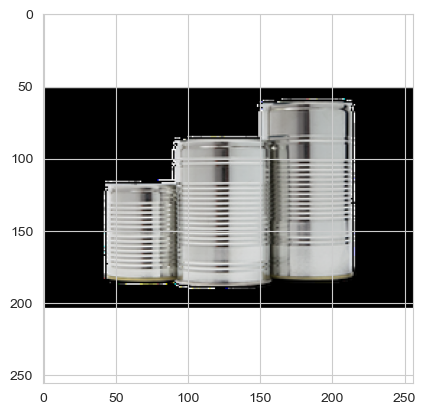

Food_Waste


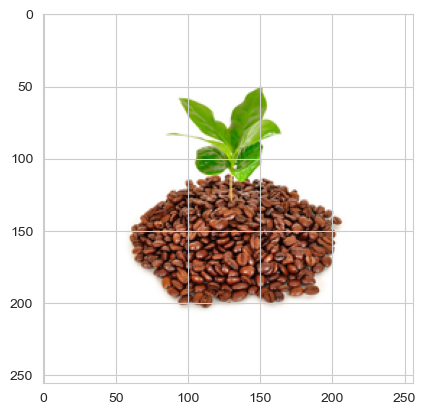

Cardboard


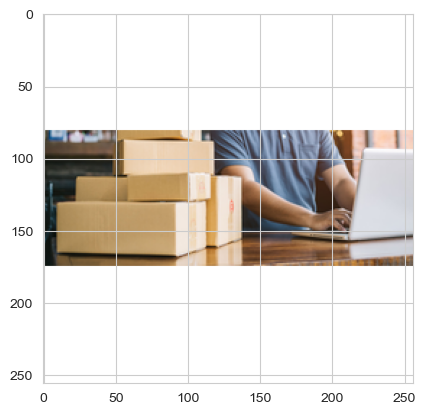

Plastic


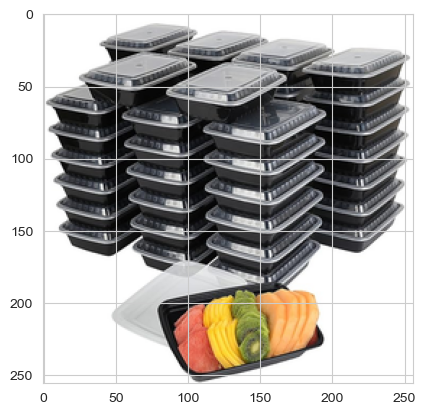

Cardboard


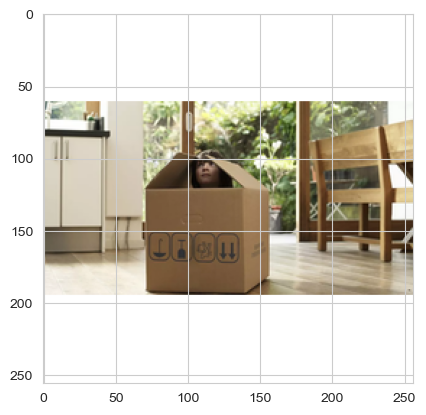

Food_Waste


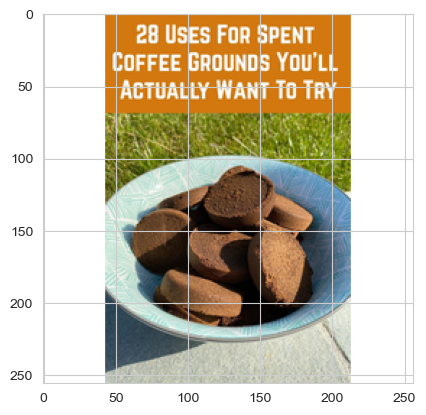

Paper


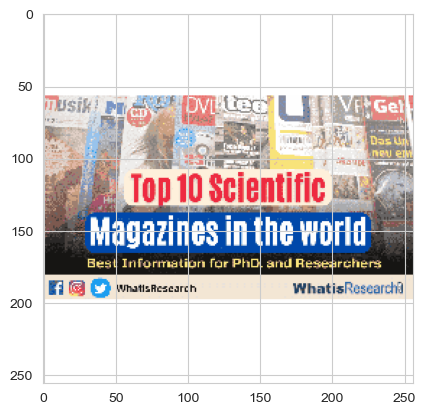

In [7]:
# Visualise Sample Images (across different labels)
for i in range(255):
    print(b[i])
    img = img_list[i].astype("int")
    plt.imshow(img)
    plt.show()

#### **2.2.3** <font color=red> [3 marks] </font><br>
Based on the smallest and largest image dimensions, resize the images.

In [21]:
# Find the smallest and largest image dimensions from the data set

print(img_list[0])


# img_list = pd.DataFrame(img_list).as_type('int')
def extract_min_max(img_list):
    min_height = np.inf
    min_width = np.inf
    max_height = 0
    max_width = 0
    for i in img_list:
        i = i.astype(float)
        # print(i.shape)
        h = i.shape[0]
        w = i.shape[1]
        if h < min_height:
            min_height = h
        if w < min_width:
            min_width = w
        if h > max_height:
            max_height = h
        if w > max_width:
            max_width = w
    return min_height, min_width, max_height, max_width


min_height, min_width, max_height, max_width = extract_min_max(img_list)
print("min height")
print(min_height)
print("min width")
print(min_width)
print("max height")
print(max_height)
print("max width")
print(max_width)

[[[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]

 [[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]

 [[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]

 ...

 [[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]

 [[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]

 [[255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]
  ...
  [255. 255. 255.]
  [255. 255. 255.]
  [255. 255. 255.]]]
min height
256
min width
256
max height
256
max width
256


In [20]:
# Resize the image dimensions
print("Since all images are of same dimensions no resizing required!")

Since all images are of same dimensions no resizing required!


### **2.3 Encoding the classes** <font color=red> [3 marks] </font><br>

There are seven classes present in the data.

We have extracted the images and their labels, and visualised their distribution. Now, we need to perform encoding on the labels. Encode the labels suitably.

####**2.3.1** <font color=red> [3 marks] </font><br>
Encode the target class labels.

In [10]:
# Encode the labels suitably
label_list = tf.keras.utils.to_categorical(label_list, 7)
label_list

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

### **2.4 Data Splitting** <font color=red> [5 marks] </font><br>

#### **2.4.1** <font color=red> [5 marks] </font><br>
Split the dataset into training and validation sets

In [11]:
# Assign specified parts of the dataset to train and validation sets
X_train, X_temp, y_train, y_temp = train_test_split(
    img_list, label_list, train_size=0.7, random_state=42
)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, train_size=0.5, random_state=42
)

X_train = np.array(X_train).astype("float32") / 255
X_test = np.array(X_test).astype("float32") / 255
print(X_train.shape)
X_train = np.array(X_train)
X_test = np.array(X_test)
y_train = np.array(y_train)
y_val = np.array(y_val)
y_test = np.array(y_test)
X_val = np.array(X_val).astype("float32") / 255

(5337, 256, 256, 3)


## **3. Model Building and Evaluation** <font color=red> [20 marks] </font><br>

### **3.1 Model building and training** <font color=red> [15 marks] </font><br>

#### **3.1.1** <font color=red> [10 marks] </font><br>
Build and compile the model. Use 3 convolutional layers. Add suitable normalisation, dropout, and fully connected layers to the model.

Test out different configurations and report the results in conclusions.

In [12]:
# Build and compile the model
model = keras.Sequential(
    [
        keras.layers.Input(shape=(256, 256, 3), batch_size=32),
        keras.layers.Conv2D(32, kernel_size=(3, 3), activation="relu", padding="same"),
        keras.layers.MaxPool2D(pool_size=(2, 2)),
        keras.layers.BatchNormalization(),
        keras.layers.Conv2D(64, kernel_size=(3, 3), activation="relu", padding="same"),
        keras.layers.MaxPool2D(pool_size=(2, 2)),
        keras.layers.BatchNormalization(),
        keras.layers.Dropout(0.25),
        keras.layers.Conv2D(128, kernel_size=(3, 3), activation="relu", padding="same"),
        keras.layers.MaxPool2D(pool_size=(2, 2)),
        keras.layers.BatchNormalization(),
        keras.layers.Dropout(0.5),
        keras.layers.Flatten(),
        keras.layers.Dense(256, activation="relu"),
        keras.layers.BatchNormalization(),
        keras.layers.Dense(7, activation="softmax"),
    ]
)
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])
model.summary()
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(
    monitor="val_accuracy", patience=5, restore_best_weights=True
)

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (32, 256, 256, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (32, 128, 128, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (32, 128, 128, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (32, 128, 128, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (32, 64, 64, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (32, 64, 64, 64)       │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (32, 64, 64, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (32, 64, 64, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (32, 32, 32, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (32, 32, 32, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (32, 32, 32, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (32, 131072)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (32, 256)              │    33,554,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (32, 256)              │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (32, 7)                │         1,799 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 33,651,655 (128.37 MB)

 Trainable params: 33,650,695 (128.37 MB)

 Non-trainable params: 960 (3.75 KB)

#### **3.1.2** <font color=red> [5 marks] </font><br>
Train the model.

Use appropriate metrics and callbacks as needed.

In [13]:
# Training

model.fit(
    X_train,
    y_train,
    epochs=50,
    batch_size=32,
    callbacks=[early_stopping],
    validation_data=(X_val, y_val),
)

Epoch 1/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 150s 884ms/step - accuracy: 0.4034 - loss: 1.7795 - val_accuracy: 0.2876 - val_loss: 2.9417
Epoch 2/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 153s 915ms/step - accuracy: 0.5541 - loss: 1.2365 - val_accuracy: 0.2797 - val_loss: 2.0804
Epoch 3/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 154s 925ms/step - accuracy: 0.6099 - loss: 1.0975 - val_accuracy: 0.4493 - val_loss: 1.5270
Epoch 4/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 161s 967ms/step - accuracy: 0.7397 - loss: 0.7701 - val_accuracy: 0.5306 - val_loss: 1.3399
Epoch 5/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 166s 992ms/step - accuracy: 0.8162 - loss: 0.5498 - val_accuracy: 0.4143 - val_loss: 2.9410
Epoch 6/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 164s 982ms/step - accuracy: 0.8820 - loss: 0.3893 - val_accuracy: 0.5734 - val_loss: 1.4744
Epoch 7/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 164s 980ms/step - accuracy: 0.9157 - loss: 0.2656 - val_accuracy: 0.5944 - val_loss: 1.5156
Epoch 8/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 165s 987ms/step - accuracy: 0.9541 -

### **3.2 Model Testing and Evaluation** <font color=red> [5 marks] </font><br>

#### **3.2.1** <font color=red> [5 marks] </font><br>
Evaluate the model on test dataset. Derive appropriate metrics.

In [14]:
# Evaluate on the test set; display suitable metrics
loss, accuracy = model.evaluate(X_test, y_test, verbose=1)
print(loss)
print(accuracy)
y_pred = model.predict(X_test)
y_pred = np.array(y_pred)
y_pred = np.argmax(y_pred, axis=1)
y_pred = to_categorical(y_pred, 7)
y_test = y_test.astype("int")
y_pred = y_pred.astype("int")
print("ytest")
print(y_test)
print("y_pred")
print(y_pred)
cm = sklearn.metrics.classification_report(y_test, y_pred)
print(cm)

36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 235ms/step - accuracy: 0.6145 - loss: 1.8200
1.8200457096099854
0.6145104765892029
36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 230ms/step
ytest
[[0 1 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]
 ...
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
y_pred
[[0 1 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 1 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]]
              precision    recall  f1-score   support

           0       0.75      0.68      0.71        81
           1       0.71      0.66      0.68       160
           2       0.45      0.61      0.51       119
           3       0.72      0.63      0.67       142
           4       0.49      0.48      0.48       145
           5       0.51      0.59      0.55       157
           6       0.69      0.65      0.67       340

   micro avg       0.61      0.61      0.61      1144
   macro avg       0.62      0.61      0.61      1144
weighted avg       0.63      0.61      0.62      11

## **4. Data Augmentation** <font color=red> [optional] </font><br>

#### **4.1 Create a Data Augmentation Pipeline**

##### **4.1.1**
Define augmentation steps for the datasets.

In [15]:
# Define augmentation steps to augment images
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

data_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.1),  # Rotates by a random 10% of 360 degrees
        layers.RandomZoom(0.1),  # Zooms in or out by a random 10%
        layers.RandomContrast(0.1),  # Adjusts contrast by a random 10%
    ],
    name="data_augmentation",
)

Augment and resample the images.
In case of class imbalance, you can also perform adequate undersampling on the majority class and augment those images to ensure consistency in the input datasets for both classes.

Augment the images.

In [16]:
from keras import Model
from keras.src.layers import GlobalAveragePooling2D
from keras.src.applications.resnet import ResNet50

# Create a function to augment the images
num_classes = 7
from tensorflow.keras.applications.resnet50 import preprocess_input

X_train, X_temp, y_train, y_temp = train_test_split(
    img_list, label_list, train_size=0.7, random_state=42
)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, train_size=0.5, random_state=42
)

X_train = np.array(X_train)
X_test = np.array(X_test)
y_train = np.array(y_train)
X_val = np.array(X_val)
y_val = np.array(y_val)
y_test = np.array(y_test)
X_train = preprocess_input(X_train)
X_val = preprocess_input(X_val)
X_test = preprocess_input(X_test)
print(X_train.shape)


def get_model():
    # Get base model
    # Here we are using ResNet50 as base model
    base_model = ResNet50(
        weights="imagenet",
        include_top=False,
        input_tensor=data_augmentation(layers.Input(shape=(256, 256, 3))),
    )

    # As we are using ResNet model only for feature extraction and not adjusting the weights
    # we freeze the layers in base model
    for layer in base_model.layers:
        layer.trainable = False

    # Get base model output
    base_model_ouput = base_model.output

    # Adding our own layer

    x = GlobalAveragePooling2D()(base_model_ouput)
    # Adding fully connected layer
    x = Dense(512, activation="relu")(x)
    x = Dense(num_classes, activation="softmax", name="fcnew")(x)

    model = Model(inputs=base_model.input, outputs=x)
    return model


model = get_model()
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])
model.summary()
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(
    monitor="val_accuracy", patience=5, restore_best_weights=True
)

(5337, 256, 256, 3)


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ data_augmentation   │ (None, 256, 256,  │          0 │ input_layer_1[0]… │
│ (Sequential)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ data_augmentatio… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c

 Total params: 24,640,391 (94.00 MB)

 Trainable params: 1,052,679 (4.02 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [17]:
# Create the augmented training dataset

##### **4.1.2**

Train the model on the new augmented dataset.

In [18]:
# Train the model using augmented images

model.fit(
    X_train,
    y_train,
    epochs=50,
    batch_size=32,
    callbacks=[early_stopping],
    validation_data=(X_val, y_val),
)

Epoch 1/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 312s 2s/step - accuracy: 0.7047 - loss: 0.8781 - val_accuracy: 0.8217 - val_loss: 0.5491
Epoch 2/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 281s 2s/step - accuracy: 0.8117 - loss: 0.5337 - val_accuracy: 0.8339 - val_loss: 0.5212
Epoch 3/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 283s 2s/step - accuracy: 0.8447 - loss: 0.4224 - val_accuracy: 0.8566 - val_loss: 0.4509
Epoch 4/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 291s 2s/step - accuracy: 0.8681 - loss: 0.3563 - val_accuracy: 0.8488 - val_loss: 0.4564
Epoch 5/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 283s 2s/step - accuracy: 0.8919 - loss: 0.3176 - val_accuracy: 0.8252 - val_loss: 0.6222
Epoch 6/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 288s 2s/step - accuracy: 0.9050 - loss: 0.2594 - val_accuracy: 0.8374 - val_loss: 0.5733
Epoch 7/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 294s 2s/step - accuracy: 0.9262 - loss: 0.2214 - val_accuracy: 0.8593 - val_loss: 0.4886
Epoch 8/50
167/167 ━━━━━━━━━━━━━━━━━━━━ 291s 2s/step - accuracy: 0.9237 - loss: 0.2136 - val_accu

In [19]:
loss, accuracy = model.evaluate(X_test, y_test, verbose=1)
print(loss)
print(accuracy)
y_pred = model.predict(X_test)
y_pred = np.array(y_pred)
y_pred = np.argmax(y_pred, axis=1)
y_pred = to_categorical(y_pred, 7)
y_test = y_test.astype("int")
y_pred = y_pred.astype("int")
print("ytest")
print(y_test)
print("y_pred")
print(y_pred)
cm = sklearn.metrics.classification_report(y_test, y_pred)
print(cm)

36/36 ━━━━━━━━━━━━━━━━━━━━ 48s 1s/step - accuracy: 0.8470 - loss: 0.5896
0.5895925164222717
0.8470279574394226
36/36 ━━━━━━━━━━━━━━━━━━━━ 50s 1s/step
ytest
[[0 1 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]
 ...
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
y_pred
[[0 1 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]
 ...
 [1 0 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
              precision    recall  f1-score   support

           0       0.99      0.81      0.89        81
           1       0.87      0.94      0.91       160
           2       0.93      0.68      0.79       119
           3       0.74      0.94      0.83       142
           4       0.81      0.87      0.84       145
           5       0.77      0.78      0.78       157
           6       0.90      0.85      0.87       340

   micro avg       0.85      0.85      0.85      1144
   macro avg       0.86      0.84      0.84      1144
weighted avg       0.86      0.85      0.85      1144
 

## **5. Conclusions** <font color = red> [5 marks]</font>

#### **5.1 Conclude with outcomes and insights gained** <font color =red> [5 marks] </font>

* Report your findings about the data
* Report model training results

Custom model with 3 Convolutional layers had about 60% accuracy. While pre trained model like Resnet50 had about 84% accuracy even after Data Augmentation. In the custom model, there were Batch Normalizations and two Dropouts. In the custom model significant overfitting was seen while this wasn't the case with Resnet50 model.Since the images were extracted using tf.keras.utils.image_dataset_from_directory all the images were of the same size and no separate min or max height was needed. But , for Resnet50 since it expects input in a certain format so the data had to be preprocessed.